# Pruebas de segmentación con el Catálogo Morfológico de Nebulosas Planetarias del IAC (NO SUPERVISADO)
En este documento vamos a probar las técnicas comentadas por Diego Cantorna en el documento de astrogestem (disponible en la carpeta astrosegstem de este mismo repositorio) y vamos a añadir ciertas técnicas y mejoras. Todas las técnicas testeadas en este Jupyter Notebook son de aprendizaje no supervisado.

## Carga del Dataset
Vamos a definir una clase, que tome como base la clase Dataset de Pytorch, para poder cargar todo nuestro conjunto de imágenes de uno o varios canales con su máscara correspondiente.

In [1]:
import os

print("Vamos a cambiar el directorio de trabajo")

# Indicamos la ruta del directorio de trabajo
route = os.getcwd()+ "/TFG/test/PNe_segmentation"
os.chdir(route)

current_directory = os.getcwd()
print(" El directorio actual es:", current_directory)

# Listamos el contenido del directorio
files = os.listdir(current_directory)
print(" Contenido del directorio actual:")
for file in files:
    print("\t",file)
    
# Listamos el contenido del directorio de las máscaras
# masks_directory = route+"TFG\\test\\PNe_segmentation\\masks"
# data_directory = route+"TFG\\test\\PNe_segmentation\\data"
## Ejecución en el CESGA Finisterrae III
masks_directory = route+"/masks"
data_directory = route+"/data"


Vamos a cambiar el directorio de trabajo
 El directorio actual es: /mnt/netapp2/Home_FT2/home/ulc/co/ela/TFG/test/PNe_segmentation
 Contenido del directorio actual:
	 commands.txt
	 data
	 create_dataset.ipynb
	 data_files_1c.csv
	 images
	 launch_jupyter.sh
	 masks
	 segmentation_no_supervisada.ipynb
	 segmentation_no_supervisada_2c.ipynb
	 segmentation_no_supervisada_pytorch.ipynb
	 segmentation_supervisada.ipynb
	 dataset_info.csv
	 data_files_1c_train.csv
	 historico_notebooks
	 data_files_1c_test.csv
	 segmentation_no_supervisada_pytorch_clean.ipynb


In [2]:
from torch.utils.data import Dataset
import matplotlib.pyplot as plt
import torch
from torchvision import transforms
from torchvision.transforms.functional import InterpolationMode
import random as rd
import numpy as np
from astropy.io import fits
from skimage import measure


MinMaxNorm = lambda x: (x - np.min(x)) / (np.max(x) - np.min(x))

class NebulaeDataset(Dataset):
    
    def __init__(self, image_path, mask_path, dataframe, rsize = None, transform = None):
        super().__init__()
        
        self.image_path = image_path  # Ruta a las imágenes
        self.mask_path = mask_path  # Ruta a las máscaras
        
        # Cargar los nombres de las imágenes y máscaras desde el dataframe
        self.data_dict = dataframe.set_index('name').to_dict(orient='index')

        # Filtrar las rutas de archivo según los nombres en el dataframe
        self.img_files = [os.path.join(self.image_path, files['h']) for files in self.data_dict.values()]
        self.mask_files = [os.path.join(self.mask_path, files['mask']) for files in self.data_dict.values()]
        self.names = list(self.data_dict.keys())  # Nombres de las imágenes y máscaras
                
        self.rsize = rsize  # Size to use in default Resize transform
        self.transform = transform

    # Returns both the image and the mask
    def __getitem__(self, index):
        img_path = self.img_files[index]
        mask_path = self.mask_files[index]
        
        image = np.flip(fits.getdata(img_path, memmap=False).astype(np.float32), axis=0)
        mask = plt.imread(mask_path)
        
        # Take only the first channel. CHANGE THIS IF WE ARE GOING TO WORK WITH NUMEROUS CHANNELS
        if len(mask.shape) > 2:
            mask = mask[:,:,0]
        if len(image.shape) > 2:
            image = image[:,:,0]
        
        # Apply the defined transformations to both image and mask
        if self.transform is not None:
            seed = np.random.randint(2147483647) # make a seed with numpy generator 
            rd.seed(seed) # apply this seed to image transforms
            torch.manual_seed(seed)
            if type(self.transform) == tuple:
                image = self.transform[0](image)
            else:
                image = self.transform(image)
            rd.seed(seed) # apply the same seed to mask transforms
            torch.manual_seed(seed) 
            if type(self.transform) == tuple:
                mask = self.transform[1](mask)
            else:
                mask = self.transform(mask)
        else:
            if self.rsize is not None:
                t = transforms.Compose([
                    MinMaxNorm,
                    transforms.ToTensor(),
                    transforms.Resize(self.rsize, interpolation= InterpolationMode.NEAREST)
                    ])
            else:
                t = transforms.Compose([
                    MinMaxNorm,
                    transforms.ToTensor()
                    ])

            image = t(image)
            mask = t(mask)
        
        return image, mask.int()

    def __len__(self):
        return len(self.img_files)
    
    def different_shapes(self):
        shapes = set([tuple(self[i][0].permute(2,1,0).shape) for i in range(len(self))])
        return list(shapes)
    
    def plot(self, index, plot_image = True, plot_mask = False):
        """
        Muestra una imagen y/o máscara aleatoria del lote.
        
        Parámetros:
        index (int): Índice del lote.
        plot_image (bool, opcional): Si es True, muestra la imagen. Por defecto es True.
        plot_mask (bool, opcional): Si es True, muestra la máscara. Por defecto es False.
        """
        image, mask = self[index]
        image = image.permute(1,2,0)
        mask = mask.permute(1,2,0)
        name = self.names[index]
        
        if plot_image:
            fig, ax = plt.subplots(1, 1, figsize=(5, 5))
            fig.suptitle(f"Canales de la nebulosa {name}", fontweight = 'bold', fontsize = 14)
            ax.imshow(image, cmap = "gray")
            ax.set_title(f"Canal H")
            fig.show()
        if plot_mask:
            fig, ax = plt.subplots(1, 1, figsize=(5, 5))
            fig.suptitle(f"Máscara de la nebulosa {name}", fontweight = 'bold', fontsize = 14)
            ax.imshow(mask, cmap = "gray")
            fig.show()
            
    def different_shapes(self):
        shapes = set([tuple(self[i][0].permute(2,1,0).shape) for i in range(len(self))])
        return list(shapes)
    
    def bg_obj_proportions(self):
        proportions = []
        for i in range(len(self)):
            mask = self[i][1].numpy()
            bg = np.sum(mask == 0)
            obj = np.sum(mask == 1)
            proportions.append(obj/(bg+obj))
        return proportions
    
    def contrast_differences(self, radius = None):
        contrasts = []
        if radius is not None:
            for i in range(len(self)):
                image = self[i][0].numpy()
                mask = self[i][1].numpy()
                bg = image[mask == 0]
                obj = image[mask == 1]
                contrasts.append(np.mean(obj) - np.mean(bg))
        else:
            for i in range(len(self)):
                image = self[i][0].numpy()
                mask = self[i][1].numpy()
                
                bg = image[mask == 0]
                obj = image[mask == 1]
                contrasts.append(np.mean(obj) - np.mean(bg))
        return contrasts


Ahora deberíamos de ser capaces de poder cargar todas las imágenes, como tensores de PyTorch, de nuestro csv como un Dataset

In [3]:
import pandas as pd
df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df)

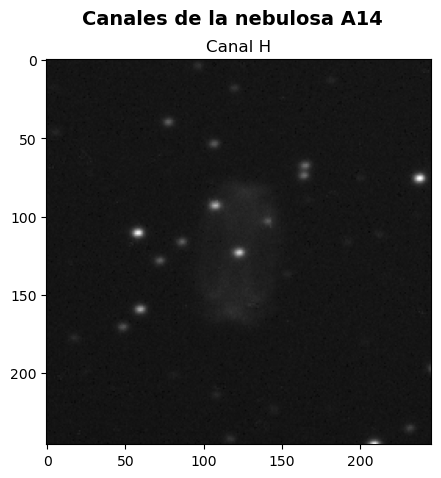

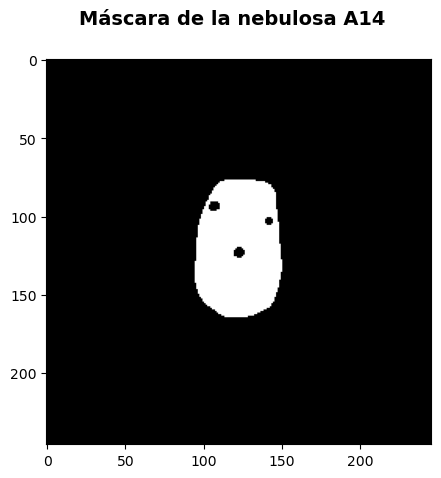

In [4]:
dataset.plot(1, plot_image = True, plot_mask = True)

## Segmentación de las imágenes
Para la segmentación de las imágenes, vamos a probar diferentes algoritmos/técnicas propuestas por Diego Cantorna en el notebook de 'astrosegstem', pero para un mayor conjunto de datos para poder evaluarlas y verificar sus resultados.

### Evaluación de resultados
Para evaluar el resultado de las técnicas de segmentación se pueden emplear distintas métricas.

Algunas de las métricas más utilizadas son la precisión, accuracy y recall, que junto al análisis de la matriz de confusión son las más utilizadas para cualquier problema de procesamiento de imágenes. A estas también se unen:
- **Coeficiente de Dice** (Dice Similarity Coefficient): Mide la similitud entre la segmentación predicha y la segmentación de referencia. Valores más cercanos a 1 indican una mejor superposición. Para un problema de segmentación binaria como el nuestro, el F1-Score y el Dice son equivalentes.
- **Índice de Jaccard** (Jaccard Index o Intersection over Union, IoU): Calcula la intersección entre la segmentación predicha y la segmentación de referencia dividida por su unión. También mide la superposición.
las cuales son métricas básicas y esenciales en los problemas de segmentación.

Vamos a utilizar todas estas métricas para evaluar nuestras técnicas de segmentación.

Vamos a dar mayor prioridad a la hora de evaluar al F1-Score (equivalente al Dice), al IoU y a la precisión, debido a que queremos extraer la silueta aunque no sea de una manera exacta. Métricas como el accuracy en este tipo de problemas no son muy representativas dado a que si el 90 por ciento de la imagen es fondo y nuestra técnica predice como máscara todo 0s (es decir, todo negro) nos va a devolver un 90 por ciento de accuracy pero realmente no nos estaría aportando ninguna información de valor. El recall sería una métrica más idónea si no nos quisiésemos saltar ningún píxel que tenemos que predecir como positivo, aunque diésemos algún falso positivo (métrica muy observada en segmentación de imagen médica por ejemplo). 

### Técnicas de agrupamiento de datos
Las técnicas de agrupamiento (clustering) tratan de encontrar una partición de un
conjunto de datos de forma que los elementos de un mismo grupo sean más similares
que los elementos de grupos distintos. Esto permite resumir un conjunto de datos,
y puede facilitar algunos procesos de visualización o análisis posteriores con otras
técnicas.

In [5]:
from sklearn.cluster import KMeans
from skimage import morphology, exposure
from scipy import ndimage
import skfuzzy as fuzz

class ApplyKMeans:
    def __init__(self, concat = False, **kwargs):
        self.concat = concat
        self.kwargs = kwargs

    def __call__(self, im):
        im_orig = im.copy()
        if len(im.shape) == 3 and im.shape[2] > 1:
            im = im[:,:,-1]
            
        im_array = im.reshape(-1, 1)
    
        kmeans = KMeans(**self.kwargs).fit(im_array)  # Entrenar el modelo K-Means
        
        # Obtener la imagen segmentada aplicando el algoritmo a cada píxel de la imagen
        im_segm_array = kmeans.predict(im_array)

        # Reemplazar los índices de los clústeres por los centroides de los clústeres
        im_segm_array = np.array([kmeans.cluster_centers_[i] for i in im_segm_array])

        # Cambiar las dimensiones de los datos segmentados para que se correspondan con la imagen inicial
        im_segm = im_segm_array.reshape(im.shape[0], im.shape[1], 1)
        
        if self.concat:
            if len(im_orig.shape) < 3:
                im_orig = np.expand_dims(im_orig, axis=2)
                
            return np.concatenate((im_orig, im_segm), axis=2)
        else:
            return im_segm

class ApplyFCM:
    def __init__(self, concat = False, **kwargs):
        self.concat = concat
        self.kwargs = kwargs

    def __call__(self, im):
        im_orig = im.copy()
        if len(im.shape) == 3 and im.shape[2] > 1:
            im = im[:,:,-1]
            
        im_array = im.reshape(1, -1)

        cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(data=im_array, **self.kwargs)  # Aplicar el algoritmo FCM
        
        # Asociar a cada píxel el cluster para el que tiene una mayor pertenencia
        clusters_array = np.argmax(u, axis=0)
        maximos = np.max(u, axis=0)

        # Reemplazar los índices de los clústeres por los centroides de los clústeres
        im_segm_array = np.array([cntr[i] for i in clusters_array])

        # Cambiar las dimensiones de los datos segmentados para que se correspondan con la imagen inicial
        im_segm = im_segm_array.reshape(im.shape[0], im.shape[1], 1)
        
        maximos = maximos.reshape(im.shape[0], im.shape[1], 1)
        im_segm = np.concatenate((maximos, im_segm), axis=2)
            
        if self.concat:
            if len(im_orig.shape) < 3:
                im_orig = np.expand_dims(im_orig, axis=2)
                
            return np.concatenate((im_orig, im_segm), axis=2)
        else:
            return im_segm

class ApplyMorphology:
    def __init__(self, operation = morphology.opening, concat = False, **kwargs):
        self.concat = concat
        self.operation = operation
        self.kwargs = kwargs
        if operation == morphology.binary_opening or operation == morphology.binary_closing:
            self.mode = "star_background"
        else:
            self.mode = "nebulae"
    
    def __call__(self, im):
        im_orig = im.copy()
        if len(im.shape) == 3 and im.shape[2] > 1:
            im = im[:,:,-1]
        
        if self.mode == "nebulae":
            im_filt = self.operation(im, **self.kwargs)
        else:
            im_preproc = np.copy(im)
            im_filt = ndimage.gaussian_filter(im, sigma=3)
            im_filt[im == 0] = 0

            im_zonas_claras_peq = im > (im_filt + np.std(im))

            im_zonas_claras_peq = self.operation(im_zonas_claras_peq, **self.kwargs)
                
            im_preproc = (im_preproc - np.min(im_preproc))
            im_preproc[im_zonas_claras_peq] = 0
            
            im_filt = im_preproc
        if self.concat:
            if len(im_orig.shape) < 3:
                im_orig = np.expand_dims(im_orig, axis=2)
                
            im_filt = np.expand_dims(im_filt, axis=2)
            return np.concatenate((im_orig, im_filt), axis=2)
        else:
            return self.operation(im, **self.kwargs)

class ApplyIntensityTransformation:
    def __init__(self, transformation = exposure.rescale_intensity, concat = False, **kwargs):
        self.transformation = transformation
        self.kwargs = kwargs
        self.concat = concat
        self.in_range = None
        self.kernel_size = None
        
        if "in_range" in self.kwargs:
            self.in_range = self.kwargs["in_range"]
        
        if "kernel_size" in self.kwargs:
            self.kernel_size = self.kwargs["kernel_size"]
    
    def __call__(self, im):
        im_orig = im.copy()
        if len(im.shape) == 3 and im.shape[2] > 1:
            im = im[:,:,-1]
        
        if self.in_range is not None:
            self.kwargs["in_range"] = (im.max() * self.in_range[0], im.max() * self.in_range[1])
        
        # self.kwargs["in_range"] = (im.min(), im.max()) # Linea para realizar un reescalado de la intensidad de la imagen lineal
        
        if self.kernel_size is not None:
            self.kwargs["kernel_size"] = im.shape[0] // self.kernel_size
            
        im_trans = self.transformation(im, **self.kwargs)
        if self.concat:
            if len(im_orig.shape) < 3:
                im_orig = np.expand_dims(im_orig, axis=2)
                
            im_trans = np.expand_dims(im_trans, axis=2)
            return np.concatenate((im_orig, im_trans), axis=2)
        else:
            return self.transformation(im, **self.kwargs)
        
class ApplyFilter:
    def __init__(self, filter = ndimage.gaussian_filter, concat = False, **kwargs):
        self.filter = filter
        self.kwargs = kwargs
        self.concat = concat
    
    def __call__(self, im):
        im_orig = im.copy()
        if len(im.shape) == 3 and im.shape[2] > 1:
            im = im[:,:,-1]
        
        im_filt = self.filter(im, **self.kwargs)
        if self.concat:
            if len(im_orig.shape) < 3:
                im_orig = np.expand_dims(im_orig, axis=2)
                
            im_filt = np.expand_dims(im_filt, axis=2)
            return np.concatenate((im_orig, im_filt), axis=2)
        else:
            return self.filter(im, **self.kwargs)
        
class CustomPad():
    def __init__(self, target_size = (1056, 1536), fill = 0):
        self.target_size = target_size
        self.fill = fill
        
    def __call__(self, image):
        # Get the size of the input image
        width, height = image.shape[2], image.shape[1]

        # Compute the size of the padding
        pad_width = self.target_size[1] - width
        pad_height = self.target_size[0] - height

        # Compute the padding
        pad_left = pad_width // 2
        pad_right = pad_width - pad_left
        pad_top = pad_height // 2
        pad_bottom = pad_height - pad_top

        # Apply the padding
        return transforms.functional.pad(image, (pad_left, pad_top, pad_right, pad_bottom), fill = self.fill)
    
    
def plot_all(image, mask, **kwargs):
        image = image.permute(1,2,0)
        mask = mask.permute(1,2,0)
        
        n_channels = image.shape[2]
        fig, ax = plt.subplots(1, n_channels + 1, figsize=(5 * n_channels, 5))
        # fig.suptitle(f"Canales de la nebulosa y máscara", fontweight = 'bold', fontsize = 14)
        for i in range(n_channels):
            ax[i].imshow(image[:,:,i]*255, **kwargs)
            ax[i].set_title(f"Canal {i}")
            
        ax[n_channels].imshow(mask, cmap = "gray")
        ax[n_channels].set_title(f"Máscara")
        fig.show()

def find_closest_points(point, contour):
    distances = np.linalg.norm(contour - point, axis=1)
    return contour[np.argmin(distances)]

def filter_cluster(image, threshold=0.90, morphology_percentage_alpha = 0.025, mask_probs = None, mode = "star_background", channel_index = 0, metric_fnc = lambda x_mean, x_std, y_mean, y_std: (x_mean / x_std) - (y_mean / y_std)) :
    """
    Filtra los clusters de una imagen binarizada para obtener el fondo.
    
    Parámetros:
    image (torch.Tensor): Imagen binarizada.
    min_background_percentage (float, opcional): Porcentaje mínimo de píxeles de fondo. Por defecto es 0.90.
    
    Retorna:
    torch.Tensor: Imagen binarizada con el fondo.
    
    """
    image_knn = image[-1]
    # Sort unique cluster values in ascending order
    unique_values = image_knn.unique(sorted=True)

    background = torch.where(image_knn == unique_values[0], torch.tensor(0), torch.tensor(1))

    old_metric = -np.inf
    
    if mode == "star_background":
        # Mientras que el porcentaje de píxeles de fondo sea menor que el porcentaje mínimo, seguimos añadiendo clusters al fondo
        for cluster_value in unique_values[1:]:
            
            add_background = torch.where(image_knn == cluster_value, torch.tensor(0), torch.tensor(1))
            new_background = background * add_background
            
            if (1 - new_background.sum() / new_background.numel()) > threshold:
                break
            
            background = new_background
        
        if mask_probs is not None:
            background = background * mask_probs
    
    elif mode == "contrast_difference":
        final_background = background.clone()
        for cluster_value in unique_values[1:]:
            bg_wo_holes = binary_closing(background, footprint=disk(image.shape[1]*morphology_percentage_alpha))
            bg_erosion = binary_erosion(bg_wo_holes, footprint=disk(image.shape[1]*morphology_percentage_alpha))

            bg_dilation = binary_dilation(background, disk(image.shape[1]*morphology_percentage_alpha*2))

            if sum(bg_erosion.flatten()) >= len(bg_erosion.flatten()) * 0.99 or sum(bg_dilation.flatten()) >= len(bg_dilation.flatten())*0.99:
                add_background = torch.where(image_knn == cluster_value, torch.tensor(0), torch.tensor(1))
                background *= add_background
                continue
            
            elif sum(bg_erosion.flatten()) == 0 or sum(bg_dilation.flatten()) == 0:
                break
            
            contour_bg_erosion = measure.find_contours(bg_erosion)
            contour_bg_dilation = measure.find_contours(bg_dilation)

            # Repetir el proceso para la máscara erosionada
            blank_image_erosion = np.zeros_like(bg_erosion, dtype=np.uint8)

            contour_max_length = max(contour_bg_erosion, key=len)
            for point in contour_max_length:
                blank_image_erosion[int(point[0]), int(point[1])] = 1

            # Repetir el proceso para la máscara dilatada
            blank_image_dilation = np.zeros_like(bg_dilation, dtype=np.uint8)

            contour_max_length = max(contour_bg_dilation, key=len)
            for point in contour_max_length:
                blank_image_dilation[int(point[0]), int(point[1])] = 1
                    
            # Calcular la diferencia entre los contornos erosionados y dilatados
            contour_values_dilation = image.permute(1,2,0).numpy()[:,:,channel_index] * blank_image_dilation
            contour_values_erosion = image.permute(1,2,0).numpy()[:,:,channel_index] * blank_image_erosion

            bp_erosion = contour_values_erosion.flatten()[contour_values_erosion.flatten()!=0]
            bp_dilation = contour_values_dilation.flatten()[contour_values_dilation.flatten()!=0]

            # Calcular la media y la desviación típica de los valores de contraste
            mean_erosion = np.mean(bp_erosion)
            std_erosion = np.std(bp_erosion)
            mean_dilation = np.mean(bp_dilation)
            std_dilation = np.std(bp_dilation)

            metric = metric_fnc(mean_erosion, std_erosion, mean_dilation, std_dilation)
            add_background = torch.where(image_knn == cluster_value, torch.tensor(0), torch.tensor(1))
            new_background = background * add_background
            
            if  metric >= threshold:
                final_background = background.clone()
                break
            
            elif metric > old_metric:
                old_metric = metric
                final_background = background.clone()
            
            background = new_background
        background = final_background
    elif mode == "mixed":
        background_percentage = threshold[0]
        threshold = threshold[1]
        
        cnt = 0
        
        # Mientras que el porcentaje de píxeles de fondo sea menor que el porcentaje mínimo, seguimos añadiendo clusters al fondo
        for cluster_value in unique_values[1:]:
            
            add_background = torch.where(image_knn == cluster_value, torch.tensor(0), torch.tensor(1))
            new_background = background * add_background
            
            cnt += 1
            if (1 - new_background.sum() / new_background.numel()) > background_percentage:
                break
            
            background = new_background
            
        if mask_probs is not None:
            background = background * mask_probs
        
        final_background = background.clone()
        
        for cluster_value in unique_values[cnt:]:
            bg_wo_holes = binary_closing(background, footprint=disk(image.shape[1]*morphology_percentage_alpha))
            bg_erosion = binary_erosion(bg_wo_holes, footprint=disk(image.shape[1]*morphology_percentage_alpha))

            bg_dilation = binary_dilation(background, disk(image.shape[1]*morphology_percentage_alpha*2))
            
            if sum(bg_erosion.flatten()) == 0 or sum(bg_dilation.flatten()) == 0:
                break
            
            contour_bg_erosion = measure.find_contours(bg_erosion)
            contour_bg_dilation = measure.find_contours(bg_dilation)

            # Repetir el proceso para la máscara erosionada
            blank_image_erosion = np.zeros_like(bg_erosion, dtype=np.uint8)

            contour_max_length = max(contour_bg_erosion, key=len)
            for point in contour_max_length:
                blank_image_erosion[int(point[0]), int(point[1])] = 1

            # Repetir el proceso para la máscara dilatada
            blank_image_dilation = np.zeros_like(bg_dilation, dtype=np.uint8)

            contour_max_length = max(contour_bg_dilation, key=len)
            for point in contour_max_length:
                blank_image_dilation[int(point[0]), int(point[1])] = 1
                    
            # Calcular la diferencia entre los contornos erosionados y dilatados
            contour_values_dilation = image.permute(1,2,0).numpy()[:,:,channel_index] * blank_image_dilation
            contour_values_erosion = image.permute(1,2,0).numpy()[:,:,channel_index] * blank_image_erosion

            bp_erosion = contour_values_erosion.flatten()[contour_values_erosion.flatten()!=0]
            bp_dilation = contour_values_dilation.flatten()[contour_values_dilation.flatten()!=0]

            # Calcular la media y la desviación típica de los valores de contraste
            mean_erosion = np.mean(bp_erosion)
            std_erosion = np.std(bp_erosion)
            mean_dilation = np.mean(bp_dilation)
            std_dilation = np.std(bp_dilation)

            metric = metric_fnc(mean_erosion, std_erosion, mean_dilation, std_dilation)
            
            add_background = torch.where(image_knn == cluster_value, torch.tensor(0), torch.tensor(1))
            new_background = background * add_background
            
            if  metric >= threshold:
                final_background = background.clone()
                break
            
            elif metric > old_metric:
                old_metric = metric
                final_background = background.clone()
                
            background = new_background
        background = final_background
    elif mode == "contrast_difference_np":
        final_background = background.clone()
        for cluster_value in unique_values[1:]:
            bg_wo_holes = binary_closing(background, footprint=disk(image.shape[1]*morphology_percentage_alpha))
            bg_erosion = binary_erosion(bg_wo_holes, footprint=disk(image.shape[1]*morphology_percentage_alpha))

            bg_dilation = binary_dilation(background, disk(image.shape[1]*morphology_percentage_alpha*2))

            if sum(bg_erosion.flatten()) >= len(bg_erosion.flatten()) * 0.99 or sum(bg_dilation.flatten()) >= len(bg_dilation.flatten())*0.99:
                add_background = torch.where(image_knn == cluster_value, torch.tensor(0), torch.tensor(1))
                background *= add_background
                continue
            
            elif sum(bg_erosion.flatten()) == 0 or sum(bg_dilation.flatten()) == 0:
                break
            
            contour_bg = measure.find_contours(background.numpy())
            contour_bg = max(contour_bg, key=len)
            
            contour_bg_erosion = measure.find_contours(bg_erosion)
            contour_bg_erosion = max(contour_bg_erosion, key=len)
            
            contour_bg_dilation = measure.find_contours(bg_dilation)
            contour_bg_dilation = max(contour_bg_dilation, key=len)

            closest_points_erosion = map(lambda x: find_closest_points(x, contour_bg_erosion), contour_bg)
            closest_points_dilation = map(lambda x: find_closest_points(x, contour_bg_dilation), contour_bg)
        
            differences_points = []
        
            for point_erosion, point_dilation in zip(closest_points_erosion, closest_points_dilation):
                value_erosion = image.permute(1,2,0).numpy()[int(point_erosion[0]), int(point_erosion[1]), channel_index]
                value_dilation = image.permute(1,2,0).numpy()[int(point_dilation[0]), int(point_dilation[1]), channel_index]
                differences_points.append(value_erosion - value_dilation)

            # Calcular la media y la desviación típica de los valores de contraste
            mean_difference = np.mean(differences_points)
            std_difference = np.std(differences_points)

            metric = metric_fnc(mean_difference, std_difference)
            
            add_background = torch.where(image_knn == cluster_value, torch.tensor(0), torch.tensor(1))
            new_background = background * add_background
            
            if  metric >= threshold:
                final_background = background.clone()
                break
            
            elif metric > old_metric:
                old_metric = metric
                final_background = background.clone()
            
            background = new_background
        background = final_background
    
    elif mode == "mixed_np":
        background_percentage = threshold[0]
        threshold = threshold[1]
        
        cnt = 0
        
        # Mientras que el porcentaje de píxeles de fondo sea menor que el porcentaje mínimo, seguimos añadiendo clusters al fondo
        for cluster_value in unique_values[1:]:
            
            add_background = torch.where(image_knn == cluster_value, torch.tensor(0), torch.tensor(1))
            new_background = background * add_background
            
            cnt += 1
            if (1 - new_background.sum() / new_background.numel()) > background_percentage:
                break
            
            background = new_background
            
        if mask_probs is not None:
            background = background * mask_probs
        
        final_background = background.clone()
        
        for cluster_value in unique_values[cnt:]:
                bg_wo_holes = binary_closing(background, footprint=disk(image.shape[1]*morphology_percentage_alpha))
                bg_erosion = binary_erosion(bg_wo_holes, footprint=disk(image.shape[1]*morphology_percentage_alpha))

                bg_dilation = binary_dilation(background, disk(image.shape[1]*morphology_percentage_alpha*2))
                
                if sum(bg_erosion.flatten()) == 0 or sum(bg_dilation.flatten()) == 0:
                    break
                
                try:
                    contour_bg = measure.find_contours(background.numpy())
                    contour_bg = max(contour_bg, key=len)
                    
                    contour_bg_erosion = measure.find_contours(bg_erosion)
                    contour_bg_erosion = max(contour_bg_erosion, key=len)
                    
                    contour_bg_dilation = measure.find_contours(bg_dilation)
                    contour_bg_dilation = max(contour_bg_dilation, key=len)
                except ValueError:
                    add_background = torch.where(image_knn == cluster_value, torch.tensor(0), torch.tensor(1))
                    background *= add_background
                    continue
                    
                closest_points_erosion = map(lambda x: find_closest_points(x, contour_bg_erosion), contour_bg)
                closest_points_dilation = map(lambda x: find_closest_points(x, contour_bg_dilation), contour_bg)

                differences_points = []
            
                for point_erosion, point_dilation in zip(closest_points_erosion, closest_points_dilation):
                    value_erosion = image.permute(1,2,0).numpy()[int(point_erosion[0]), int(point_erosion[1]), channel_index]
                    value_dilation = image.permute(1,2,0).numpy()[int(point_dilation[0]), int(point_dilation[1]), channel_index]
                    differences_points.append(value_erosion - value_dilation)

                # Calcular la media y la desviación típica de los valores de contraste
                mean_difference = np.mean(differences_points)
                std_difference = np.std(differences_points)

                metric = metric_fnc(mean_difference, std_difference)
                
                add_background = torch.where(image_knn == cluster_value, torch.tensor(0), torch.tensor(1))
                new_background = background * add_background
                
                if  metric >= threshold:
                    final_background = background.clone()
                    break
                
                elif metric > old_metric:
                    old_metric = metric
                    final_background = background.clone()
                    
                background = new_background
        background = final_background
        
    else:
        raise ValueError("mode must be 'star_background', 'contrast_difference', 'contrast_difference_np, 'mixed' or 'mixed_np'")
    
    return background

### K-Means
Vamos a comenzar por la técnica más básica (y en la que se basan la mayoría), K-Means.

Para aplicar el algoritmo se selecciona el número de grupos a utilizar y un prototipo (elemento representativo) de cada grupo. A continuación se realiza un proceso iterativo en el que se van asignando datos al grupo más próximo, se recalcula el prototipo de cada grupo, y se repite el proceso hasta que se estabiliza. 

En este caso aplicaremos el algoritmo a los píxeles de imágenes de niveles de gris, por lo que el prototipo de cada grupo será el valor de un píxel. El número de grupos podemos establecerlo manualmente, realizando pruebas con distintos valores. Existen algoritmos más complejos que tratan de automatizar el proceso, pero es interesante familiarizarse inicialmente con las versiones más simples de los algoritmos, para centrar el estudio en los aspectos fundamentales.


Las pruebas con el K-Means van a ser realizadas con un modelo K-Means para cada imagen (para ambos canales) normalizando los datos entre 0 y 1 y dejandolos con sus valores reales (Demostrado que funciona exactamente igual, solo se realizará con los datos normalizados para que todas las imágenes se muevan en el mismo rango de valores).

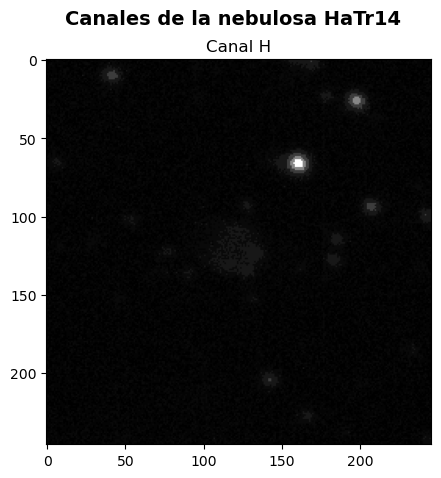

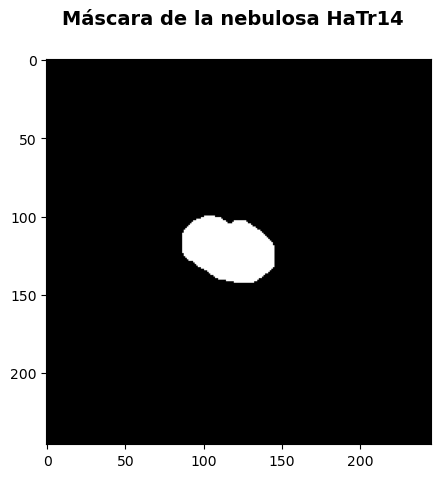

In [6]:
from typing import Any
from sklearn.cluster import KMeans
    
transform_x = transforms.Compose([
                    MinMaxNorm,
                    ApplyKMeans(concat=False, n_clusters=7, max_iter=10, n_init=10, random_state=42),
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = -1)
                    ])

transform_y = transforms.Compose([
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = 0)
                    ])

# Prueba normalizando los datos entre 0 y 1
df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df, transform = (transform_x, transform_y))

dataset.plot(40, plot_image = True, plot_mask = True)

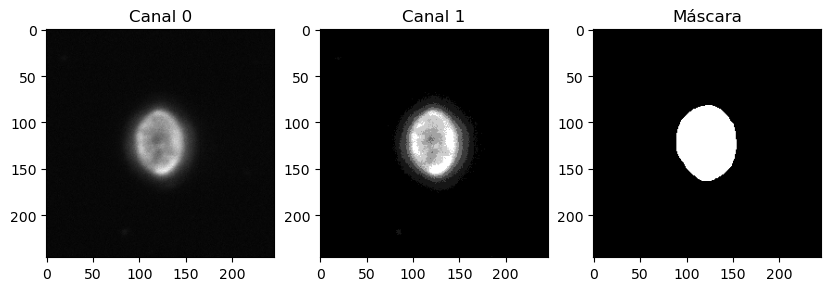

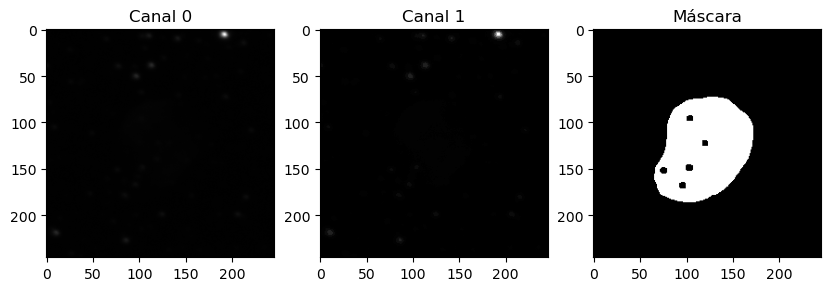

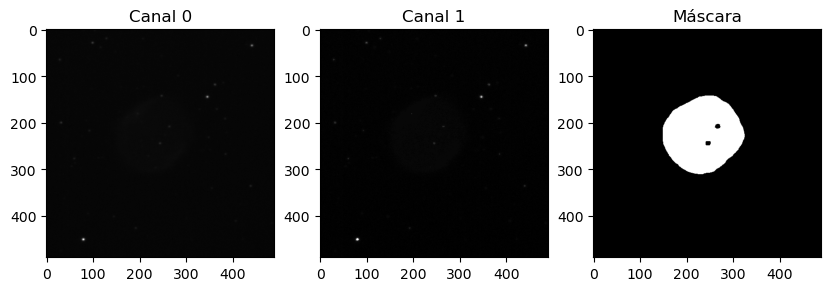

In [7]:
transform_x = transforms.Compose([
                    MinMaxNorm,
                    ApplyKMeans(concat=True, n_clusters=7, max_iter=10, n_init=10, random_state=42),
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = -1)
                    ])

transform_y = transforms.Compose([
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = 0)
                    ])

# Prueba normalizando los datos entre 0 y 1
df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df, transform = (transform_x, transform_y))

rd.seed(42)
random_indexs = rd.sample(range(len(dataset)), 3)
for index in random_indexs:
    plot_all(*dataset[index], cmap = "gray")

#### TÉCNICAS DE FILTRADO DE CLUSTERS

##### ***Filtrado de los clusters (porcentaje de fondo)***

Vamos a realizar un filtrado de los cluster de la siguiente manera:

1. Tomamos el cluster con el valor de centroide más bajo y lo tomamos como fondo
    1. Si el cluster considerado como fondo es demasiado pequeño, nos fijamos en el siguiente cluster con el centroide más bajo
    2. Si el siguiente cluster con los valores de centroide más bajo es muy pequeño nos fijamos en el para considerarlo también como fondo. (Esta parte finalmente no le veo mucho sentido implementarlo, debido a que es practicamente lo mismo que variar el umbral general)
2. El resto que no se ha considerado como fondo se considera como nebulosa consiguiendo una primera aproximación a la segmentación

Comenzamos haciendo un análisis de las proporciones de fondo que hay en nuestro conjunto de entrenamiento

In [8]:
# Prueba normalizando los datos entre 0 y 1
df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df)

# Celda para observar las proporciones de fondo máximas, mínimas y medias de las imágenes para decidir el umbral de segmentación
nebulae_proportions = dataset.bg_obj_proportions()
print(f"Mean background proportion: {1-np.mean(nebulae_proportions):.4f}\nMax background proportion: {1-min(nebulae_proportions):.4f}\nMin background proportion: {1-max(nebulae_proportions):.4f}")

Mean background proportion: 0.8932
Max background proportion: 0.9949
Min background proportion: 0.4176


Probamos el algoritmo que vamos a utilizar para filtrar los clusters según el criterio de fondo de estrellas. Con esta celda nos es muy fácil visualizar los resultados de la segmentación.

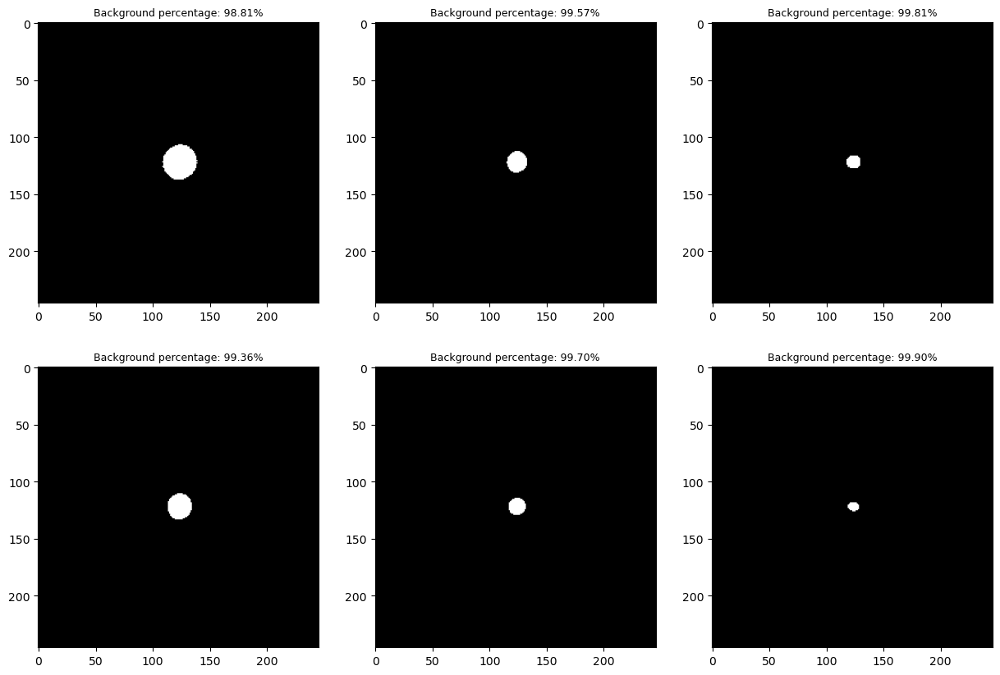

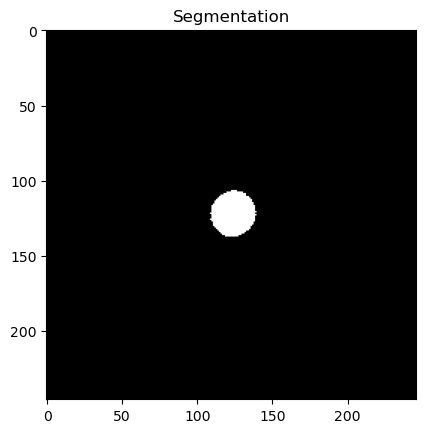

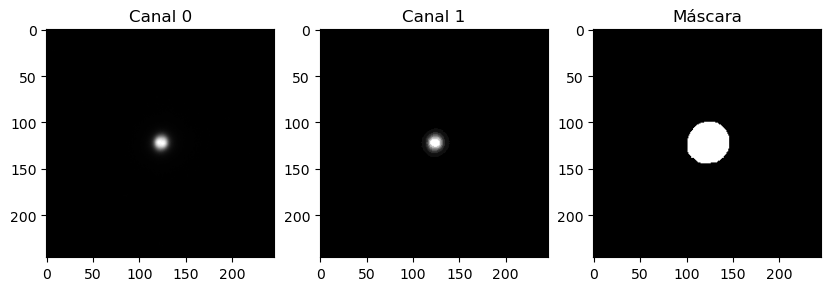

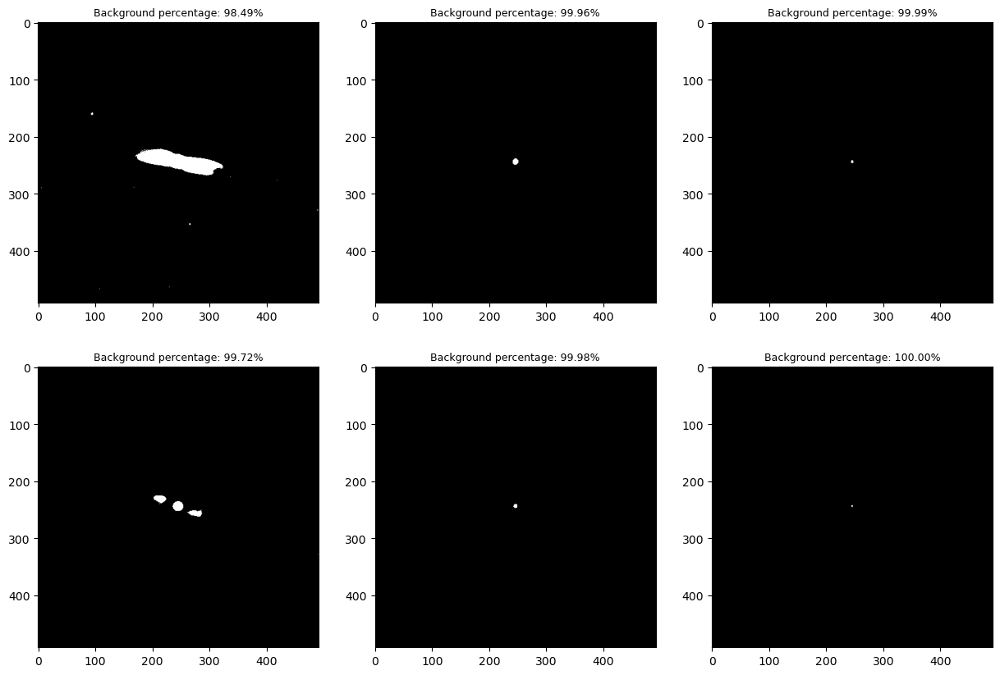

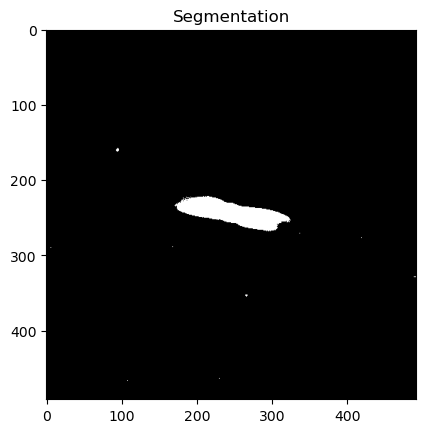

...

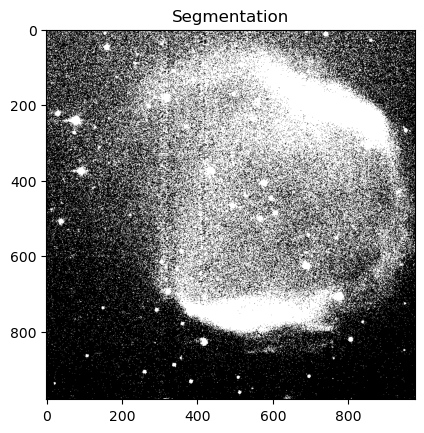

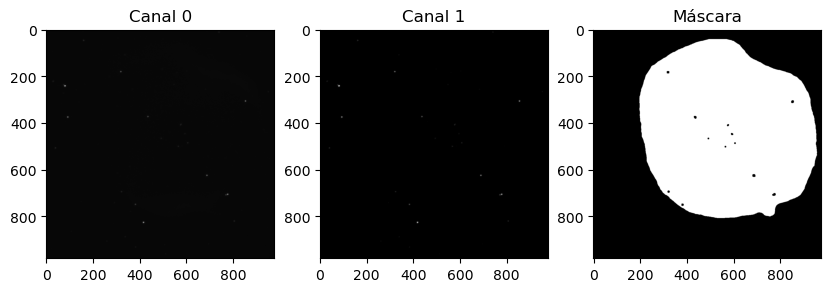

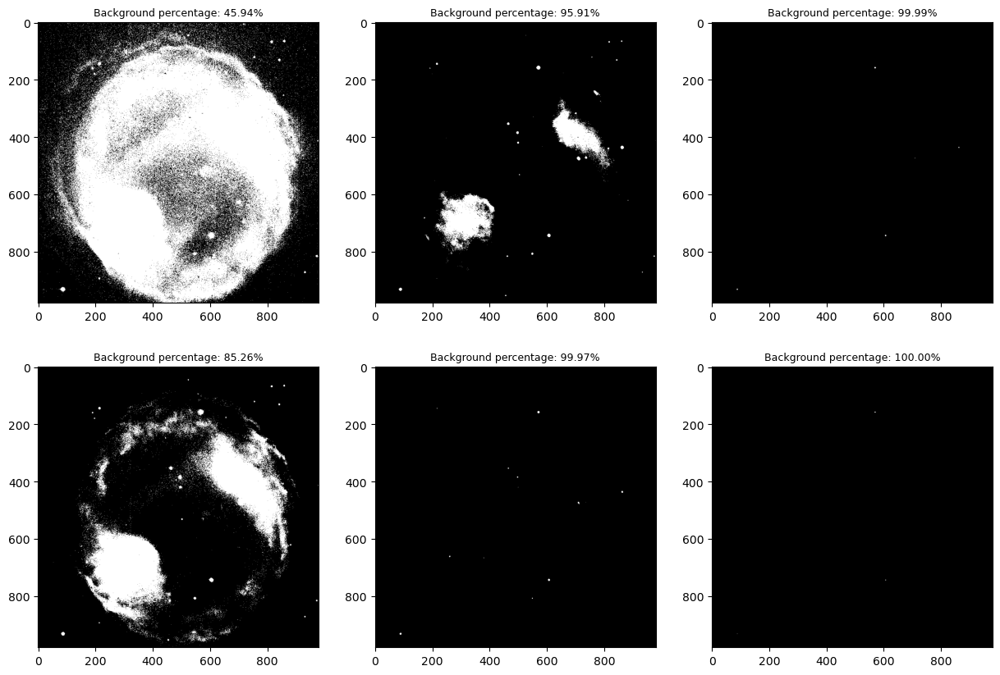

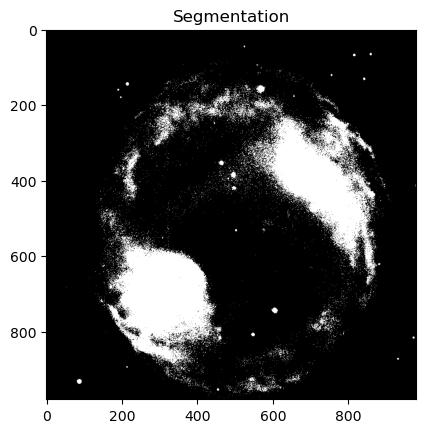

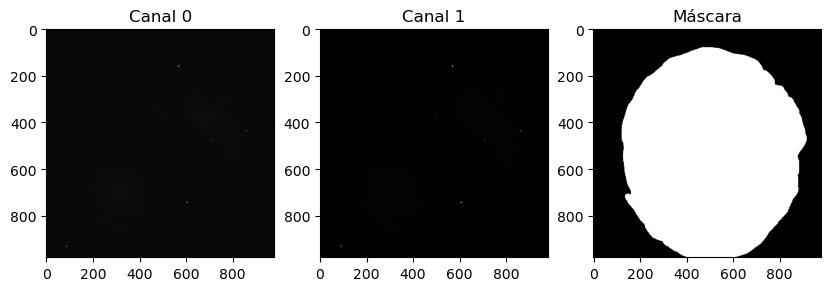

In [9]:
# Celda de código donde se realizan algunas pruebas para comprobar los resultados de la segmentación
# Más adelante se implementa este código en una función que se puede llamar desde el script principal

transform_x = transforms.Compose([
                    MinMaxNorm,
                    # ApplyFilter(filter = ndimage.gaussian_filter, concat = True, sigma = 3),
                    ApplyKMeans(concat=True, n_clusters=7, max_iter=10, n_init=10, random_state=42),
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = -1)
                    ])

transform_y = transforms.Compose([
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = 0)
                    ])

# Prueba normalizando los datos entre 0 y 1
df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df, transform = (transform_x, transform_y))

for i in range(50,60):
    image_original, mask = dataset[i]
    image = image_original[-1]
    
    min_background_percentage = 0.925
    # min_add_background_percentage = 0.2

    # Sort unique cluster values in ascending order
    unique_values = image.unique(sorted=True)

    background = torch.where(image == unique_values[0], torch.tensor(0), torch.tensor(1))

    fig, ax = plt.subplots(2, (len(unique_values)-1)//2 + (len(unique_values)-1)%2, figsize=(5 * (len(unique_values)-1)//2, 5 * 2))
    cnt = 0
    solution = False
    
    # Mientras que el porcentaje de píxeles de fondo sea menor que el porcentaje mínimo, seguimos añadiendo clusters al fondo
    for cluster_value in unique_values[1:]:
        j, i = divmod(cnt, 2)
        ax[i, j].set_title(f"Background percentage: {(1 - background.sum() / background.numel())*100:.2f}%", fontsize = 9)
        ax[i, j].imshow(background, cmap = "gray")
        fig.show()
        
        add_background = torch.where(image == cluster_value, torch.tensor(0), torch.tensor(1))
        new_background = background * add_background
        
        if (1 - new_background.sum() / new_background.numel()) > min_background_percentage and not solution:
            final_background = background.clone()
            solution = True
        #     if add_background.sum() / add_background.numel() > min_add_background_percentage:
        #         break
        #     else:
        #         continue

        background = new_background
        
        cnt += 1
    
    plt.figure()
    plt.imshow(final_background, cmap = "gray")
    plt.title(f"Segmentation")
    plt.show()
    
    plot_all(image_original, mask, cmap = "gray")

##### ***Filtrado de los clusters (diferencia de contraste)***

Otro tipo de filtrado de clusters que vamos a probar va a ser el siguiente:
- 1er cluster se considera como fondo
- Siguiente cluster se calcula la diferencia de contraste entre x píxeles hacia el interior y x hacia el exterior.
- Si la diferencia entra dentro de unos umbrales definidos (mediante el análisis anterior) se para de procesar clusters, sino se sigue procesando el siguiente.

Comenzamos probando algunas partes del algoritmo que más tarde vamos a implementar como es la selección de los píxeles dentro y fuera de la nebulosa que se van a utilizar para el cálculo de la diferencia de contrastes

Text(0.5, 1.0, 'Dilation mask')

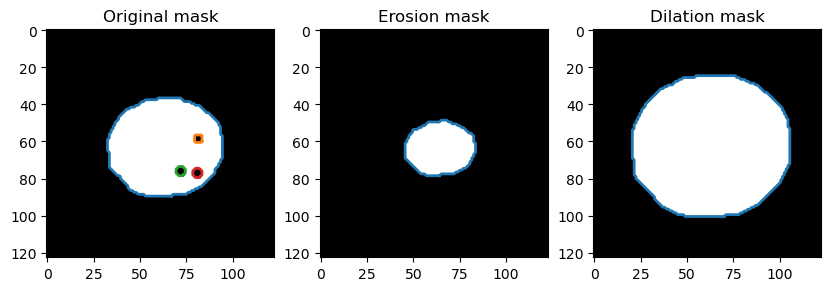

In [10]:
from skimage.morphology import binary_erosion, binary_dilation, disk, reconstruction, binary_closing
from skimage import measure

df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df)

image, mask = dataset[34]

mask_wo_holes = binary_closing(mask[0].numpy(), footprint=disk(image.shape[1]*0.1))
mask_erosion = binary_erosion(mask_wo_holes, footprint=disk(image.shape[1]*0.1))

mask_dilation = binary_dilation(mask[0].numpy(), disk(image.shape[1]*0.1))

contour_mask = measure.find_contours(mask[0].numpy())
contour_mask_erosion = measure.find_contours(mask_erosion)
contour_mask_dilation = measure.find_contours(mask_dilation)

fig, axis = plt.subplots(1, 3, figsize=(10, 5))

axis[0].imshow(mask.permute(1,2,0), cmap = "gray")
for contour in contour_mask:
    axis[0].plot(contour[:, 1], contour[:, 0], linewidth=2)
axis[0].set_title("Original mask")

axis[1].imshow(mask_erosion, cmap = "gray")
for contour in contour_mask_erosion:
    axis[1].plot(contour[:, 1], contour[:, 0], linewidth=2)
axis[1].set_title("Erosion mask")

axis[2].imshow(mask_dilation, cmap = "gray")
for contour in contour_mask_dilation:
    axis[2].plot(contour[:, 1], contour[:, 0], linewidth=2)
axis[2].set_title("Dilation mask")
    

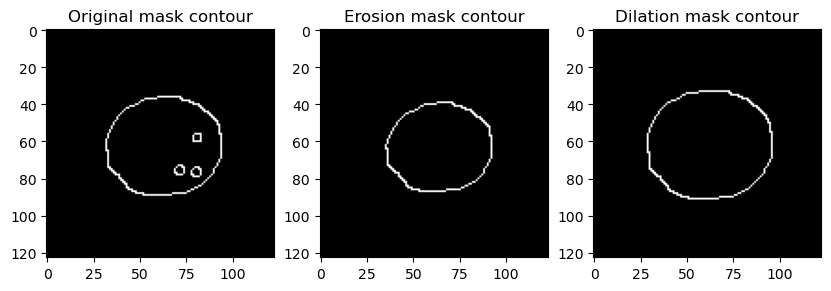

In [11]:
from skimage.morphology import binary_erosion, binary_dilation, disk, reconstruction, binary_closing
from skimage import measure
import numpy as np

image, mask = dataset[34]

mask_wo_holes = binary_closing(mask[0].numpy(), footprint=disk(image.shape[1]*0.025))
mask_erosion = binary_erosion(mask_wo_holes, footprint=disk(image.shape[1]*0.025))

mask_dilation = binary_dilation(mask[0].numpy(), disk(image.shape[1]*0.025))

contour_mask = measure.find_contours(mask[0].numpy())
contour_mask_erosion = measure.find_contours(mask_erosion)
contour_mask_dilation = measure.find_contours(mask_dilation)

fig, axis = plt.subplots(1, 3, figsize=(10, 5))

# Crear una imagen en blanco del mismo tamaño que la máscara
blank_image = np.zeros_like(mask[0].numpy())

# Dibujar los contornos en la imagen en blanco
for contour in contour_mask:
    for point in contour:
        blank_image[int(point[0]), int(point[1])] = 1

axis[0].imshow(blank_image, cmap="gray")
axis[0].set_title("Original mask contour")

# Repetir el proceso para la máscara erosionada
blank_image_erosion = np.zeros_like(mask_erosion)

for contour in contour_mask_erosion:
    for point in contour:
        blank_image_erosion[int(point[0]), int(point[1])] = 1

axis[1].imshow(blank_image_erosion, cmap="gray")
axis[1].set_title("Erosion mask contour")

# Repetir el proceso para la máscara dilatada
blank_image_dilation = np.zeros_like(mask_dilation)

for contour in contour_mask_dilation:
    for point in contour:
        blank_image_dilation[int(point[0]), int(point[1])] = 1

axis[2].imshow(blank_image_dilation, cmap="gray")
axis[2].set_title("Dilation mask contour")

plt.show()


Ahora que ya sabemos como extraer una máscara del contorno de x píxeles hacia el interior de la máscara y hacia el exterior. Podemos realizar el calculo de la diferencia de diferentes maneras, como por ejemplo:

$$\text{{media\_diferencia\_contraste}} = \frac{{\sum(\text{{pixeles\_interior}})}}{{\text{{count}}(\text{{pixeles\_interior}})}} - \frac{{\sum(\text{{pixeles\_exterior}})}}{{\text{{count}}(\text{{pixeles\_exterior}})}}$$

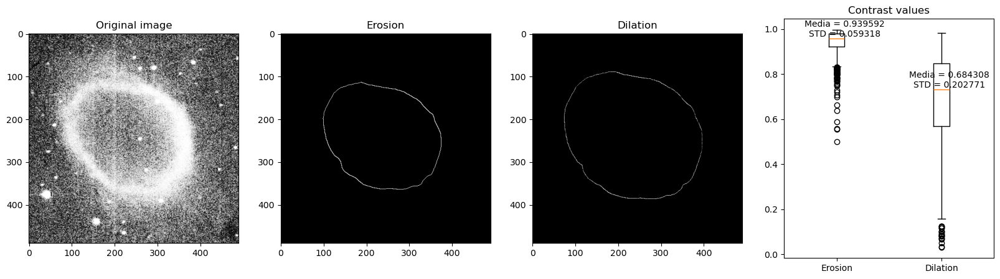

In [35]:
from skimage.morphology import binary_erosion, binary_dilation, disk, reconstruction, binary_closing
from skimage import measure
import numpy as np

# Para esta prueba puede ser interesante trabajar siempre con las imágenes después de aplicar una adaptación del histograma
transform_x = transforms.Compose([
                    MinMaxNorm,
                    ApplyIntensityTransformation(concat=True, transformation=exposure.equalize_hist, nbins = 4096),
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = -1)
                    ])

transform_y = transforms.Compose([
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = 0)
                    ])

df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df, transform = (transform_x, transform_y))

# Descomentar las siguientes dos líneas para trabajar con las imágenes originales
# df = pd.read_csv("data_files_1c_train.csv")
# dataset = NebulaeDataset(data_directory, masks_directory, df)

image, mask = dataset[0]

mask_wo_holes = binary_closing(mask[0].numpy(), footprint=disk(image.shape[1]*0.025))
mask_erosion = binary_erosion(mask_wo_holes, footprint=disk(image.shape[1]*0.025))

mask_dilation = binary_dilation(mask[0].numpy(), disk(image.shape[1]*0.025))

contour_mask = measure.find_contours(mask[0].numpy())
contour_mask_erosion = measure.find_contours(mask_erosion)
contour_mask_dilation = measure.find_contours(mask_dilation)

# Repetir el proceso para la máscara erosionada
blank_image_erosion = np.zeros_like(mask_erosion, dtype=np.uint8)

for contour in contour_mask_erosion:
    for point in contour:
        blank_image_erosion[int(point[0]), int(point[1])] = 1

# Repetir el proceso para la máscara dilatada
blank_image_dilation = np.zeros_like(mask_dilation, dtype=np.uint8)

for contour in contour_mask_dilation:
    for point in contour:
        blank_image_dilation[int(point[0]), int(point[1])] = 1
        
# Calcular la diferencia entre los contornos erosionados y dilatados
contour_values_dilation = image.permute(1,2,0).numpy()[:,:,-1] * blank_image_dilation
contour_values_erosion = image.permute(1,2,0).numpy()[:,:,-1] * blank_image_erosion

fig, axis = plt.subplots(1, 4, figsize=(20, 5))
axis[0].imshow(image.permute(1,2,0).numpy()[:,:,-1], cmap="gray")
axis[0].set_title("Original image")

axis[1].imshow(contour_values_erosion, cmap="gray")
axis[1].set_title("Erosion")
axis[2].imshow(contour_values_dilation, cmap="gray")
axis[2].set_title("Dilation")

bp_erosion = contour_values_erosion.flatten()[contour_values_erosion.flatten()!=0]
bp_dilation = contour_values_dilation.flatten()[contour_values_dilation.flatten()!=0]

# Calcular la media y la desviación típica de los valores de contraste
media_erosion = np.mean(bp_erosion)
std_erosion = np.std(bp_erosion)
media_dilation = np.mean(bp_dilation)
std_dilation = np.std(bp_dilation)

# Crear el gráfico de cajas
bp = axis[3].boxplot([bp_erosion, bp_dilation], labels=["Erosion", "Dilation"])
axis[3].set_title("Contrast values")

# Agregar las líneas de la media y la desviación típica al gráfico de cajas
for i, line in enumerate(bp['medians']):
    x, y = line.get_xydata()[1]
    if i == 0:
        text = f'Media = {media_erosion:.6f}\nSTD = {std_erosion:.6f}'
    else:
        text = f'Media = {media_dilation:.6f}\nSTD = {std_dilation:.6f}'
    axis[3].text(x, y, text, horizontalalignment ='center', verticalalignment='bottom') 

plt.show()
        

Realizamos un análisis de la diferencia de contraste medio que hay en nuestro conjunto de entrenamiento y empezamos a calcular algunos valores de posibles umbrales.

In [36]:
from skimage.morphology import binary_erosion, binary_dilation, disk, reconstruction, binary_closing
from skimage import measure
import numpy as np

# Para esta prueba puede ser interesante trabajar siempre con las imágenes después de aplicar una adaptación del histograma
transform_x = transforms.Compose([
                    MinMaxNorm,
                    # ApplyMorphology(operation = morphology.binary_opening, concat = True, footprint = morphology.disk(2)),
                    # ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    ApplyIntensityTransformation(transformation = exposure.equalize_hist, concat = True, nbins = 4096),
                    # ApplyIntensityTransformation(transformation = exposure.equalize_adapthist, concat = True, nbins = 640, kernel_size = 5),
                    # ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    # ApplyFilter(filter = ndimage.gaussian_filter, concat = True, sigma = 5),
                    # ApplyKMeans(concat=True, n_clusters=7, max_iter=10, n_init=10, random_state=42),
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = -1)
                    ])

transform_y = transforms.Compose([
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = 0)
                    ])

df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df, transform = (transform_x, transform_y))

# Descomentar las siguientes dos líneas para trabajar con las imágenes originales
# df = pd.read_csv("data_files_1c_train.csv")
# dataset = NebulaeDataset(data_directory, masks_directory, df)

means_erosion = []
stds_erosion = []
means_dilation = []
stds_dilation = []

for i in range(0, len(dataset)):

    image, mask = dataset[i]

    mask_wo_holes = binary_closing(mask[0].numpy(), footprint=disk(image.shape[1]*0.025))
    mask_erosion = binary_erosion(mask_wo_holes, footprint=disk(image.shape[1]*0.025))

    mask_dilation = binary_dilation(mask[0].numpy(), disk(image.shape[1]*0.025*2))

    contour_mask = measure.find_contours(mask[0].numpy())
    contour_mask_erosion = measure.find_contours(mask_erosion)
    contour_mask_dilation = measure.find_contours(mask_dilation)

    # Repetir el proceso para la máscara erosionada
    blank_image_erosion = np.zeros_like(mask_erosion, dtype=np.uint8)

    for contour in contour_mask_erosion:
        for point in contour:
            blank_image_erosion[int(point[0]), int(point[1])] = 1

    # Repetir el proceso para la máscara dilatada
    blank_image_dilation = np.zeros_like(mask_dilation, dtype=np.uint8)

    for contour in contour_mask_dilation:
        for point in contour:
            blank_image_dilation[int(point[0]), int(point[1])] = 1
            
    # Calcular la diferencia entre los contornos erosionados y dilatados
    contour_values_dilation = image.permute(1,2,0).numpy()[:,:,-1] * blank_image_dilation
    contour_values_erosion = image.permute(1,2,0).numpy()[:,:,-1] * blank_image_erosion

    bp_erosion = contour_values_erosion.flatten()[contour_values_erosion.flatten()!=0]
    bp_dilation = contour_values_dilation.flatten()[contour_values_dilation.flatten()!=0]

    # Calcular la media y la desviación típica de los valores de contraste
    means_erosion.append(np.mean(bp_erosion))
    stds_erosion.append(np.std(bp_erosion))
    means_dilation.append(np.mean(bp_dilation))
    stds_dilation.append(np.std(bp_dilation))

print(f"Mean erosion contrast: {np.mean(means_erosion):.6f} +/- {np.mean(stds_erosion):.6f}")
print(f"Mean dilation contrast: {np.mean(means_dilation):.6f} +/- {np.mean(stds_dilation):.6f}")
    
    

Mean erosion contrast: 0.896082 +/- 0.070203
Mean dilation contrast: 0.624220 +/- 0.203752


|           |     mean |      std |
|:----------|---------:|---------:|
| erosion contrast (original)       | 0.104527 | +/- 0.033307  |
| dilation contrast (original)        | 0.044751  | +/- 0.019040 |
||
| erosion contrast (histogram adaptation) | 0.891953 | +/- 0.072304 |
| dilation contrast (histogram adaptation)  | 0.705133 | +/- 0.171274 |

In [37]:
print(np.mean(means_erosion) / np.std(means_erosion) - np.mean(means_dilation) / np.std(means_dilation))

4.703754


Probamos el algoritmo que vamos a utilizar para filtrar los clusters según el criterio diferencias de contraste entre nebulosa y fondo. Con esta celda nos es muy fácil visualizar los resultados de la segmentación.

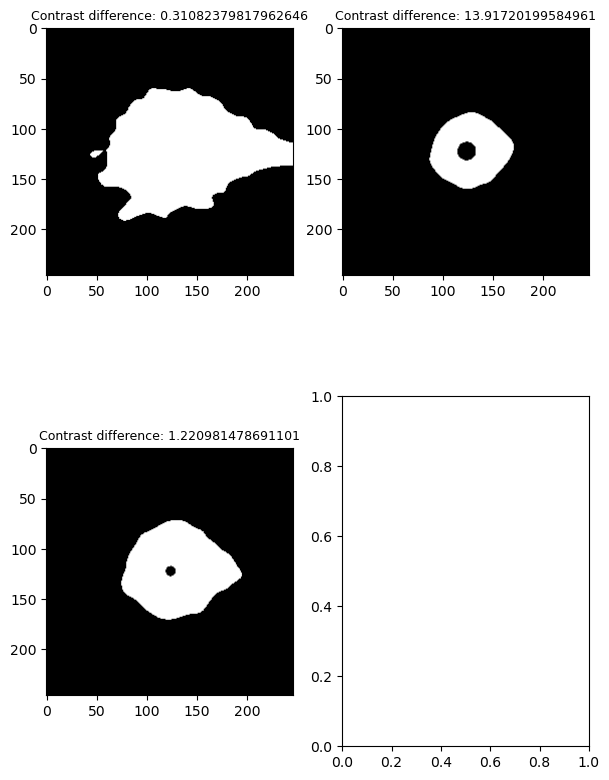

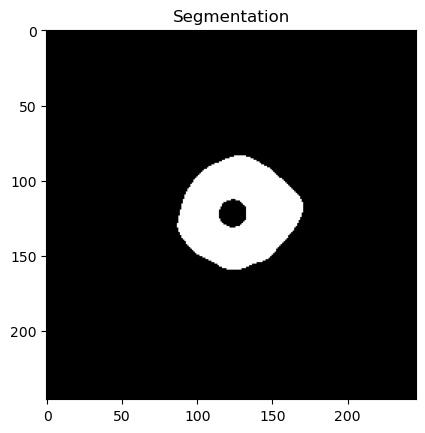

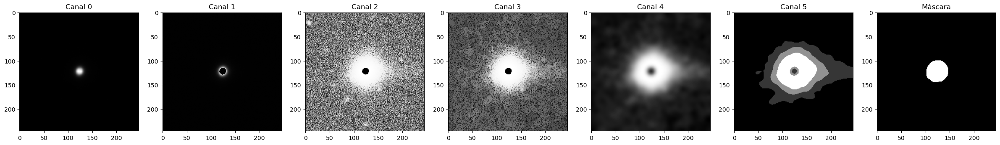

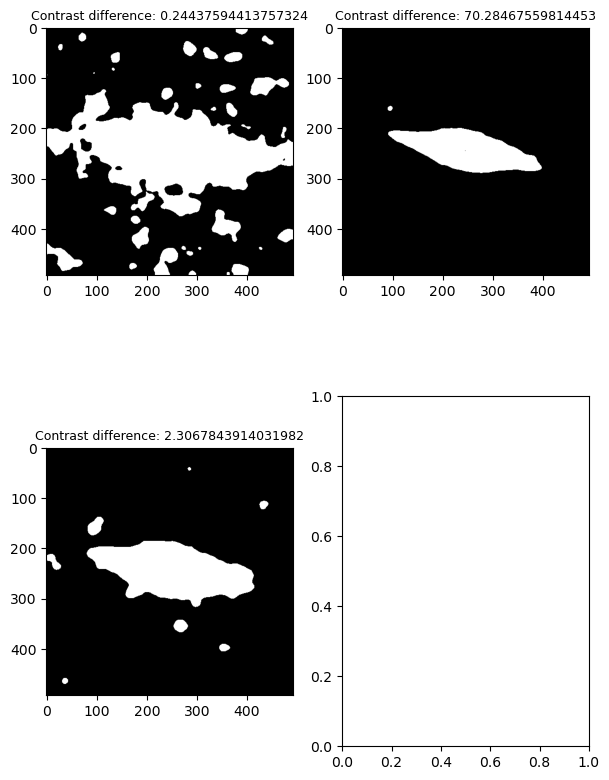

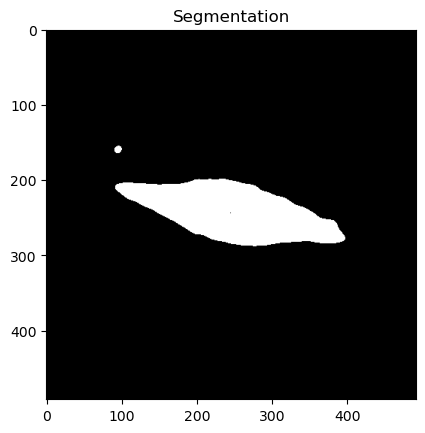

...

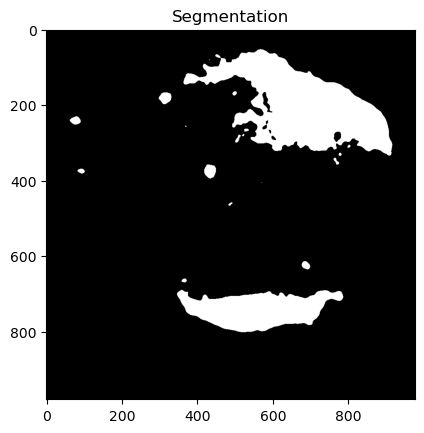

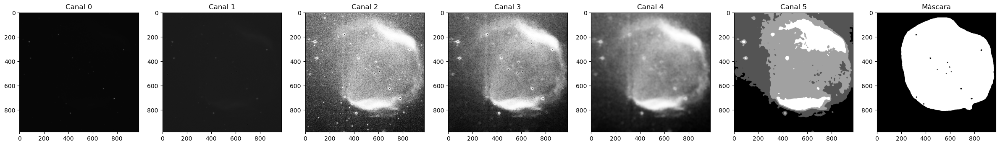

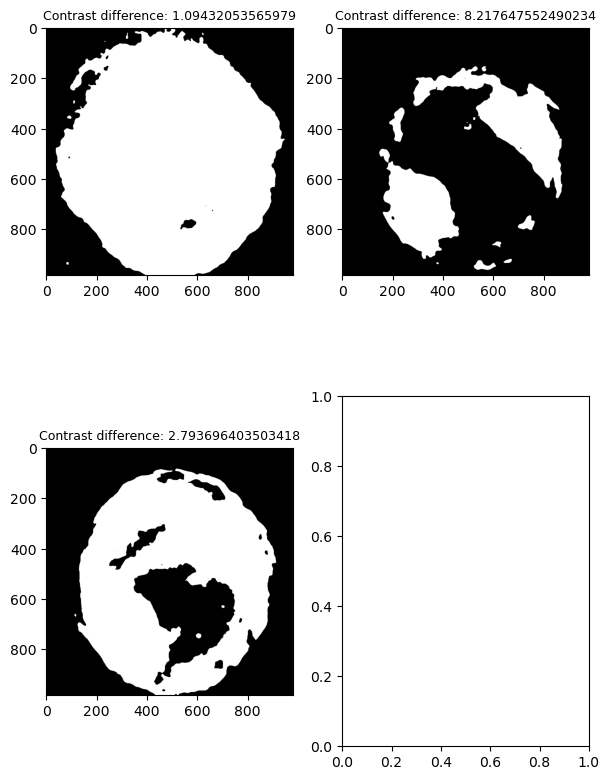

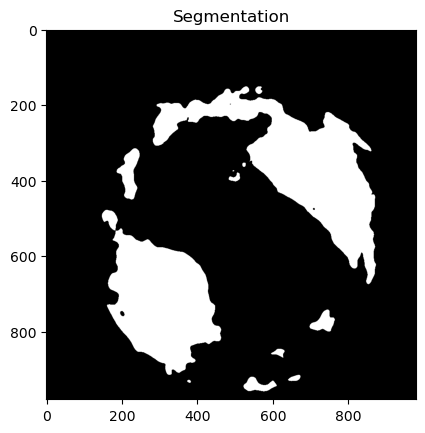

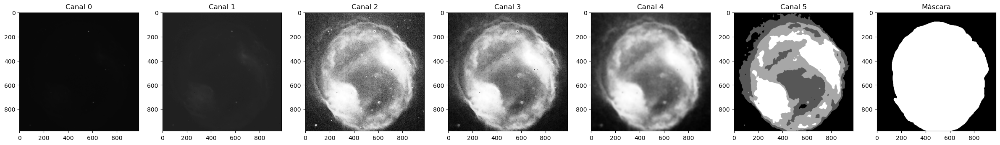

In [39]:
# Celda de código donde se realizan algunas pruebas para comprobar los resultados de la segmentación
# Más adelante se implementa este código en una función que se puede llamar desde el script principal

transform_x = transforms.Compose([
                    MinMaxNorm,
                    ApplyMorphology(operation = morphology.binary_opening, concat = True, footprint = morphology.disk(2)),
                    # ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    ApplyIntensityTransformation(transformation = exposure.equalize_hist, concat = True, nbins = 4096),
                    # ApplyIntensityTransformation(transformation = exposure.equalize_adapthist, concat = True, nbins = 640, kernel_size = 5),
                    ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    ApplyFilter(filter = ndimage.gaussian_filter, concat = True, sigma = 5),
                    ApplyKMeans(concat=True, n_clusters=4, max_iter=10, n_init=10, random_state=42),
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = -1)
                    ])

transform_y = transforms.Compose([
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = 0)
                    ])

# Prueba normalizando los datos entre 0 y 1
df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df, transform = (transform_x, transform_y))

for i in range(50,60):
    image_original, mask = dataset[i]
    image = image_original[-1]
    
    morphology_percentage_alpha = 0.025
    
    # Si se utiliza la imagen original
    # threshold = 1.75
    
    # Si se utiliza la imagen adaptada
    threshold = 4

    # Sort unique cluster values in ascending order
    unique_values = image.unique(sorted=True)

    background = torch.where(image == unique_values[0], torch.tensor(0), torch.tensor(1))
    final_background = background.clone()
    
    fig, ax = plt.subplots(2, (len(unique_values)-1)//2 + (len(unique_values)-1)%2, figsize=(5 * (len(unique_values)-1)//2, 5 * 2))
    cnt = 0
    solution = False
    
    old_metric = -np.inf
    # Mientras que el porcentaje de píxeles de fondo sea menor que el porcentaje mínimo, seguimos añadiendo clusters al fondo
    for cluster_value in unique_values[1:]:
        bg_wo_holes = binary_closing(background, footprint=disk(image_original.shape[1]*morphology_percentage_alpha))
        bg_erosion = binary_erosion(bg_wo_holes, footprint=disk(image_original.shape[1]*morphology_percentage_alpha))

        bg_dilation = binary_dilation(background, disk(image_original.shape[1]*morphology_percentage_alpha*2))

        if sum(bg_erosion.flatten()) >= len(bg_erosion.flatten()) * 0.99 or sum(bg_dilation.flatten()) >= len(bg_dilation.flatten()) * 0.99:
            add_background = torch.where(image == cluster_value, torch.tensor(0), torch.tensor(1))
            background *= add_background
            continue
        elif sum(bg_erosion.flatten()) == 0 or sum(bg_dilation.flatten()) == 0:
            print("No more clusters to add", i)
            break
        
        contour_bg_erosion = measure.find_contours(bg_erosion)
        contour_bg_dilation = measure.find_contours(bg_dilation)

        # Repetir el proceso para la máscara erosionada
        blank_image_erosion = np.zeros_like(bg_erosion, dtype=np.uint8)

        contour_max_length = max(contour_bg_erosion, key=len)
        for point in contour_max_length:
            blank_image_erosion[int(point[0]), int(point[1])] = 1

        # Repetir el proceso para la máscara dilatada
        blank_image_dilation = np.zeros_like(bg_dilation, dtype=np.uint8)

        contour_max_length = max(contour_bg_dilation, key=len)
        for point in contour_max_length:
            blank_image_dilation[int(point[0]), int(point[1])] = 1
                
        # Calcular la diferencia entre los contornos erosionados y dilatados
        
        # ## Valores de KMeans
        # contour_values_dilation = image.permute(1,2,0).numpy()[:,:,-1] * blank_image_dilation
        # contour_values_erosion = image.permute(1,2,0).numpy()[:,:,-1] * blank_image_erosion
        
        ## Valores de Original
        # contour_values_dilation = image_original.permute(1,2,0).numpy()[:,:,0] * blank_image_dilation
        # contour_values_erosion = image_original.permute(1,2,0).numpy()[:,:,0] * blank_image_erosion
        
        # ## Valores de Adaptive Equalization
        contour_values_dilation = image_original.permute(1,2,0).numpy()[:,:,2] * blank_image_dilation
        contour_values_erosion = image_original.permute(1,2,0).numpy()[:,:,2] * blank_image_erosion

        bp_erosion = contour_values_erosion.flatten()[contour_values_erosion.flatten()!=0]
        bp_dilation = contour_values_dilation.flatten()[contour_values_dilation.flatten()!=0]

        # Calcular la media y la desviación típica de los valores de contraste
        mean_erosion = np.mean(bp_erosion)
        std_erosion = np.std(bp_erosion)
        mean_dilation = np.mean(bp_dilation)
        std_dilation = np.std(bp_dilation)
    
        j, i = divmod(cnt, 2)
        
        # metric = (mean_erosion - std_erosion) - (mean_dilation - std_dilation)
        metric = mean_erosion / std_erosion - mean_dilation / std_dilation
        # metric = mean_erosion - mean_dilation
        # metric = mean_erosion*std_erosion - mean_dilation*std_dilation

        ax[i, j].set_title(f"Contrast difference: {metric}", fontsize = 9)
        ax[i, j].imshow(background, cmap = "gray")
        fig.show()
        
        add_background = torch.where(image == cluster_value, torch.tensor(0), torch.tensor(1))
        new_background = background * add_background
        
        if  metric >= threshold and not solution:
            final_background = background.clone()
            solution = True
        
        elif not solution and metric > old_metric:
            old_metric = metric
            final_background = background.clone()
            
        background = new_background
        
        cnt += 1
    
    plt.figure()
    plt.imshow(final_background, cmap = "gray")
    plt.title(f"Segmentation")
    plt.show()
    
    plot_all(image_original, mask, cmap = "gray")

En esta siguiente celda se fusionan las dos técnicas anteriores para observar que tal pueden funcionar combinadas

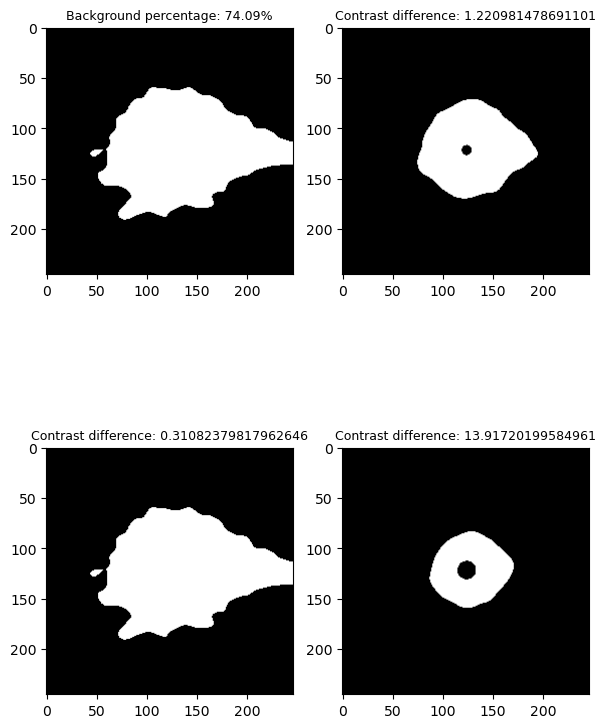

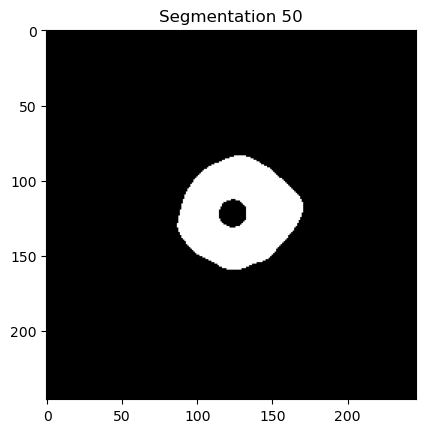

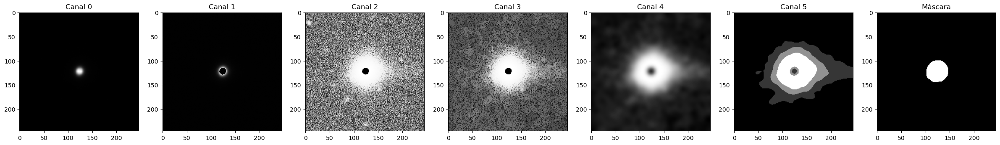

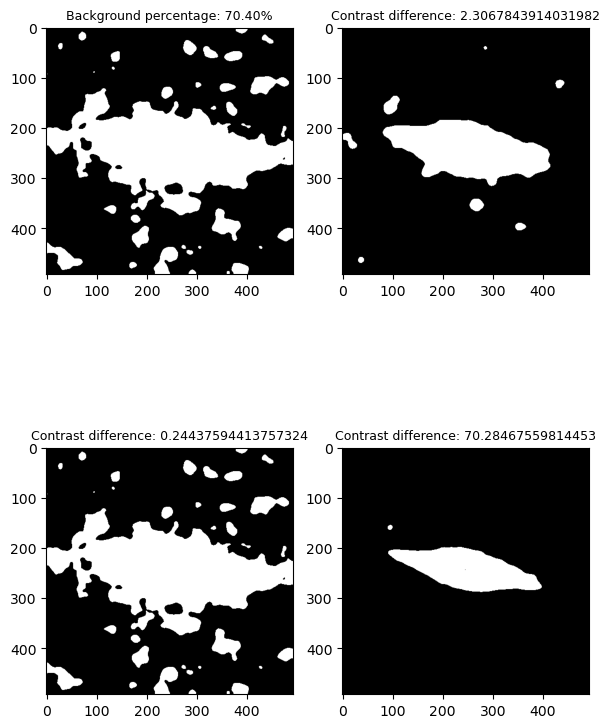

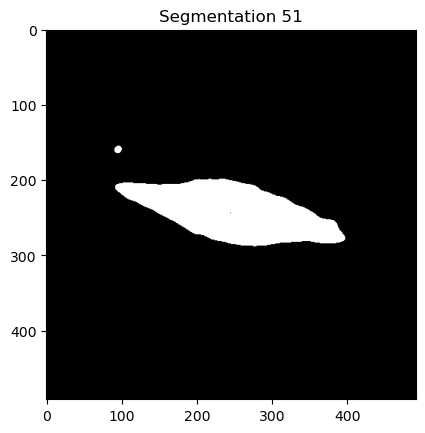

...

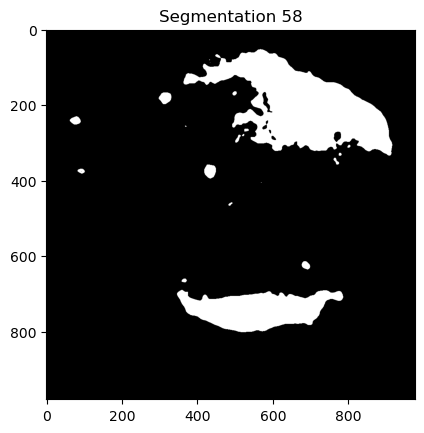

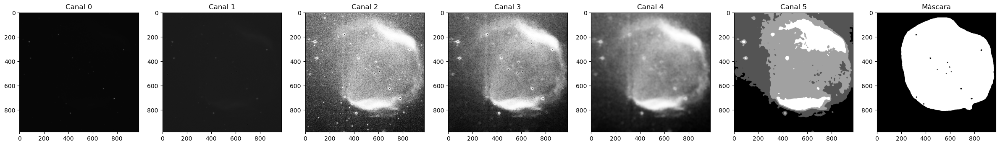

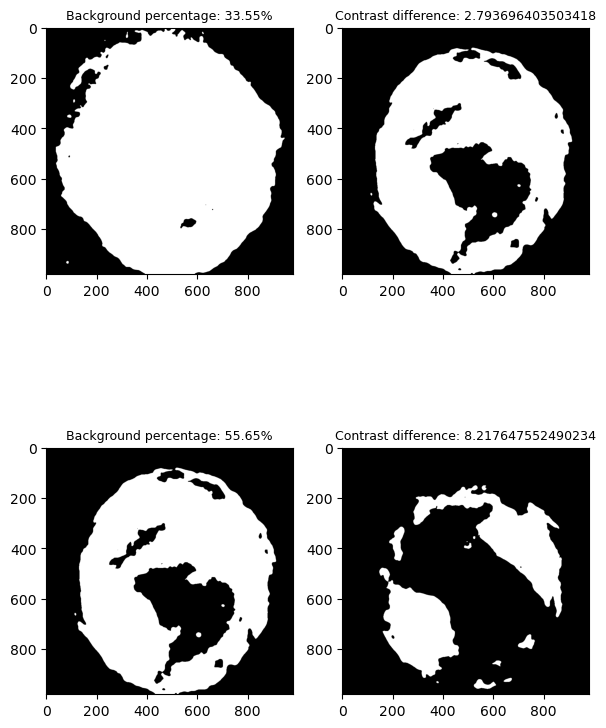

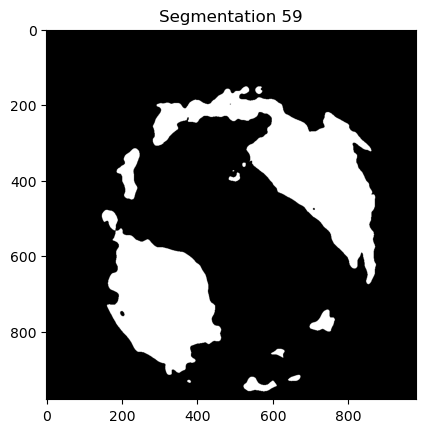

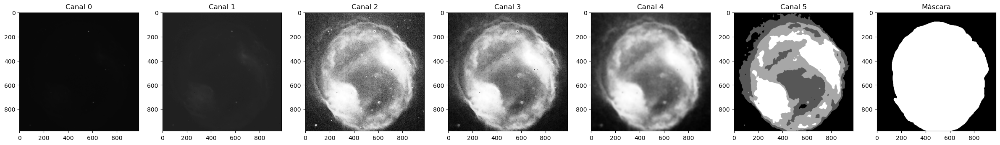

In [41]:
# Celda de código donde se realizan algunas pruebas para comprobar los resultados de la segmentación
# Más adelante se implementa este código en una función que se puede llamar desde el script principal

transform_x = transforms.Compose([
                    MinMaxNorm,
                    ApplyMorphology(operation = morphology.binary_opening, concat = True, footprint = morphology.disk(2)),
                    # ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    ApplyIntensityTransformation(transformation = exposure.equalize_hist, concat = True, nbins = 4096),
                    # ApplyIntensityTransformation(transformation = exposure.equalize_adapthist, concat = True, nbins = 640, kernel_size = 5),
                    ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    ApplyFilter(filter = ndimage.gaussian_filter, concat = True, sigma = 5),
                    ApplyKMeans(concat=True, n_clusters=4, max_iter=10, n_init=10, random_state=42),
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = -1)
                    ])

transform_y = transforms.Compose([
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = 0)
                    ])

# Prueba normalizando los datos entre 0 y 1
df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df, transform = (transform_x, transform_y))

for idx in range(50,60):
    image_original, mask = dataset[idx]
    image = image_original[-1]
    
    morphology_percentage_alpha = 0.025
    
    min_background_percentage = 0.65
    
    # Si se utiliza la imagen original
    # threshold = 1.5
    
    # Si se utiliza la imagen adaptada
    threshold = 4

    # Sort unique cluster values in ascending order
    unique_values = image.unique(sorted=True)

    background = torch.where(image == unique_values[0], torch.tensor(0), torch.tensor(1))
    final_background = background.clone()
    
    fig, ax = plt.subplots(2, (len(unique_values)-1)//2 + (len(unique_values)-1)%2, figsize=(5 * (len(unique_values)-1)//2, 5 * 2))
    cnt = 0
    solution = False
    
    old_metric = -np.inf
    # Mientras que el porcentaje de píxeles de fondo sea menor que el porcentaje mínimo, seguimos añadiendo clusters al fondo
    
    # Mientras que el porcentaje de píxeles de fondo sea menor que el porcentaje mínimo, seguimos añadiendo clusters al fondo
    for cluster_value in unique_values[1:]:
        j, i = divmod(cnt, 2)
        ax[i, j].set_title(f"Background percentage: {(1 - background.sum() / background.numel())*100:.2f}%", fontsize = 9)
        ax[i, j].imshow(background, cmap = "gray")
        fig.show()
        
        add_background = torch.where(image == cluster_value, torch.tensor(0), torch.tensor(1))
        new_background = background * add_background

        cnt += 1
        if (1 - new_background.sum() / new_background.numel()) > min_background_percentage and not solution:
            final_background = background.clone()
            break
        
        background = new_background
        
    for cluster_value in unique_values[cnt:]:
        bg_wo_holes = binary_closing(background, footprint=disk(image_original.shape[1]*morphology_percentage_alpha))
        bg_erosion = binary_erosion(bg_wo_holes, footprint=disk(image_original.shape[1]*morphology_percentage_alpha))

        bg_dilation = binary_dilation(background, disk(image_original.shape[1]*morphology_percentage_alpha*2))

        if sum(bg_erosion.flatten()) == 0 or sum(bg_dilation.flatten()) == 0:
            print(f"Cluster {cluster_value} has been added to the background")
            break
        
        contour_bg_erosion = measure.find_contours(bg_erosion)
        contour_bg_dilation = measure.find_contours(bg_dilation)

        # Repetir el proceso para la máscara erosionada
        blank_image_erosion = np.zeros_like(bg_erosion, dtype=np.uint8)

        contour_max_length = max(contour_bg_erosion, key=len)
        for point in contour_max_length:
            blank_image_erosion[int(point[0]), int(point[1])] = 1

        # Repetir el proceso para la máscara dilatada
        blank_image_dilation = np.zeros_like(bg_dilation, dtype=np.uint8)

        contour_max_length = max(contour_bg_dilation, key=len)
        for point in contour_max_length:
            blank_image_dilation[int(point[0]), int(point[1])] = 1
                
        # Calcular la diferencia entre los contornos erosionados y dilatados
        
        # ## Valores de KMeans
        # contour_values_dilation = image.permute(1,2,0).numpy()[:,:,-1] * blank_image_dilation
        # contour_values_erosion = image.permute(1,2,0).numpy()[:,:,-1] * blank_image_erosion
        
        ## Valores de Original
        # contour_values_dilation = image_original.permute(1,2,0).numpy()[:,:,0] * blank_image_dilation
        # contour_values_erosion = image_original.permute(1,2,0).numpy()[:,:,0] * blank_image_erosion
        
        # ## Valores de Adaptive Equalization
        contour_values_dilation = image_original.permute(1,2,0).numpy()[:,:,2] * blank_image_dilation
        contour_values_erosion = image_original.permute(1,2,0).numpy()[:,:,2] * blank_image_erosion

        bp_erosion = contour_values_erosion.flatten()[contour_values_erosion.flatten()!=0]
        bp_dilation = contour_values_dilation.flatten()[contour_values_dilation.flatten()!=0]

        # Calcular la media y la desviación típica de los valores de contraste
        mean_erosion = np.mean(bp_erosion)
        std_erosion = np.std(bp_erosion)
        mean_dilation = np.mean(bp_dilation)
        std_dilation = np.std(bp_dilation)
        
        j, i = divmod(cnt, 2)

        # metric = (mean_erosion - std_erosion) - (mean_dilation - std_dilation)
        metric = mean_erosion / std_erosion - mean_dilation / std_dilation
        # metric = mean_erosion - mean_dilation
        # metric = mean_erosion*std_erosion - mean_dilation*std_dilation
        
        ax[i, j].set_title(f"Contrast difference: {metric}", fontsize = 9)
        ax[i, j].imshow(background, cmap = "gray")
        fig.show()
        
        cnt += 1
        
        add_background = torch.where(image == cluster_value, torch.tensor(0), torch.tensor(1))
        new_background = background * add_background
        
        if  metric >= threshold and not solution:
            final_background = background.clone()
            solution = True
        
        elif not solution and metric > old_metric:
            old_metric = metric
            final_background = background.clone()
            
        background = new_background
    
    plt.figure()
    plt.imshow(final_background, cmap = "gray")
    plt.title(f"Segmentation {idx}")
    plt.show()
    
    plot_all(image_original, mask, cmap = "gray")

##### ***Filtrado de los clusters (diferencia de contraste) Pt. 2***
También vamos a probar otra manera de realizar el filtrado de los clusters con la diferencia de contraste. Vamos a seguir el siguiente algoritmo:

- 1er cluster se considera como fondo
- Se buscan los puntos más cercanos de los contornos del exterior y del interior de la nebulosa para cada punto del contorno exacto de la nebulosa.
- Se calcula la diferencia de contraste para cada par de puntos hallados para el contorno exacto.
- Se calcula la media de todas las diferencias.
- Si la diferencia entra dentro de unos umbrales definidos (mediante el análisis anterior) se para de procesar clusters, sino se sigue procesando el siguiente.

Text(0.5, 1.0, 'Dilation mask')

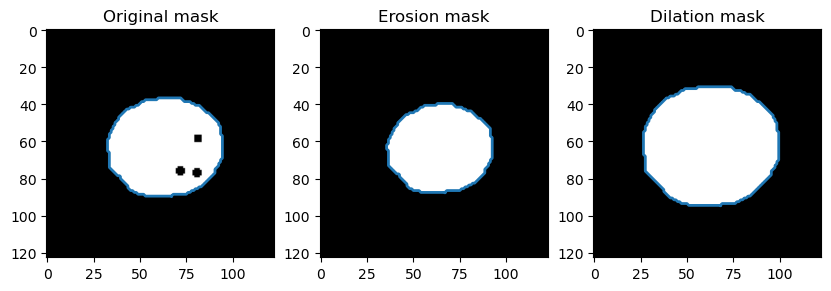

In [45]:
from skimage.morphology import binary_erosion, binary_dilation, disk, reconstruction, binary_closing
from skimage import measure

df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df)

image, mask = dataset[34]

mask_wo_holes = binary_closing(mask[0].numpy(), footprint=disk(image.shape[1]*0.025))
mask_erosion = binary_erosion(mask_wo_holes, footprint=disk(image.shape[1]*0.025))

mask_dilation = binary_dilation(mask[0].numpy(), disk(image.shape[1]*0.025*2))

contour_mask = measure.find_contours(mask[0].numpy())
contour_mask = [max(contour_mask, key=len)]

contour_mask_erosion = measure.find_contours(mask_erosion)
contour_mask_dilation = measure.find_contours(mask_dilation)

fig, axis = plt.subplots(1, 3, figsize=(10, 5))

axis[0].imshow(mask.permute(1,2,0), cmap = "gray")
for contour in contour_mask:
    axis[0].plot(contour[:, 1], contour[:, 0], linewidth=2)
axis[0].set_title("Original mask")

axis[1].imshow(mask_erosion, cmap = "gray")
for contour in contour_mask_erosion:
    axis[1].plot(contour[:, 1], contour[:, 0], linewidth=2)
axis[1].set_title("Erosion mask")

axis[2].imshow(mask_dilation, cmap = "gray")
for contour in contour_mask_dilation:
    axis[2].plot(contour[:, 1], contour[:, 0], linewidth=2)
axis[2].set_title("Dilation mask")
    

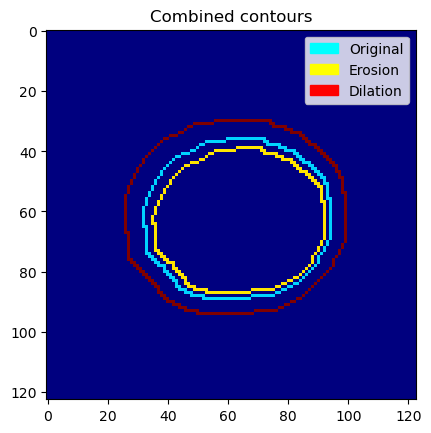

In [46]:
from skimage.morphology import binary_erosion, binary_dilation, disk, reconstruction, binary_closing
from skimage import measure
import numpy as np
from matplotlib.patches import Patch

image, mask = dataset[34]

mask_wo_holes = binary_closing(mask[0].numpy(), footprint=disk(image.shape[1]*0.025))
mask_erosion = binary_erosion(mask_wo_holes, footprint=disk(image.shape[1]*0.025))

mask_dilation = binary_dilation(mask[0].numpy(), disk(image.shape[1]*0.025*2))

contour_mask = measure.find_contours(mask[0].numpy())
contour_mask = [max(contour_mask, key=len)]

contour_mask_erosion = measure.find_contours(mask_erosion)
contour_mask_dilation = measure.find_contours(mask_dilation)

# Crear una imagen en blanco del mismo tamaño que la máscara
blank_image = np.zeros_like(mask[0].numpy())


# Dibujar los contornos en la imagen en blanco
for contour in contour_mask:
    for point in contour:
        blank_image[int(point[0]), int(point[1])] = 1

# blank_image[int(contour_mask[0][100][0]), int(contour_mask[0][100][1])] = 4

for contour in contour_mask_erosion:
    for point in contour:
        blank_image[int(point[0]), int(point[1])] = 2
        
for contour in contour_mask_dilation:
    for point in contour:
        blank_image[int(point[0]), int(point[1])] = 3

# blank_image[int(43.5), int(51)] = 4
legend_elements = [Patch(facecolor='cyan', edgecolor='cyan', label='Original'),
                   Patch(facecolor='yellow', edgecolor='yellow', label='Erosion'),
                   Patch(facecolor='red', edgecolor='red', label='Dilation')]

plt.legend(handles=legend_elements, loc='upper right')
plt.imshow(blank_image, cmap="jet")
plt.title("Combined contours")
plt.show()

The length of the original contour match with the number of closest points in each contour: True


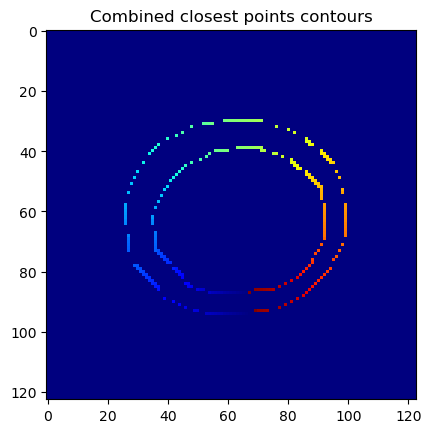

In [47]:
from skimage.morphology import binary_erosion, binary_dilation, disk, reconstruction, binary_closing
from skimage import measure
import numpy as np
from matplotlib.patches import Patch

image, mask = dataset[34]

mask_wo_holes = binary_closing(mask[0].numpy(), footprint=disk(image.shape[1]*0.025))
mask_erosion = binary_erosion(mask_wo_holes, footprint=disk(image.shape[1]*0.025))

mask_dilation = binary_dilation(mask[0].numpy(), disk(image.shape[1]*0.025*2))

contour_mask = measure.find_contours(mask[0].numpy())
contour_mask = [max(contour_mask, key=len)]

contour_mask_erosion = measure.find_contours(mask_erosion)
contour_mask_dilation = measure.find_contours(mask_dilation)

# Crear una imagen en blanco del mismo tamaño que la máscara
blank_image = np.zeros_like(mask[0].numpy())

closest_points_erosion = map(lambda x: find_closest_points(x, contour_mask_erosion[0]), contour_mask[0])
closest_points_dilation = map(lambda x: find_closest_points(x, contour_mask_dilation[0]), contour_mask[0])

cnt_erosion = 0
for point in closest_points_erosion:
    blank_image[int(point[0]), int(point[1])] = cnt_erosion
    cnt_erosion += 1

cnt_dilation = 0
for point in closest_points_dilation:
    blank_image[int(point[0]), int(point[1])] = cnt_dilation
    cnt_dilation += 1

plt.imshow(blank_image, cmap="jet")
plt.title("Combined closest points contours")

print("The length of the original contour match with the number of closest points in each contour:", len(contour_mask[0]) == cnt_erosion == cnt_dilation)

In [48]:
from skimage.morphology import binary_erosion, binary_dilation, disk, reconstruction, binary_closing
from skimage import measure
import numpy as np
from matplotlib.patches import Patch

image, mask = dataset[34]

mask_wo_holes = binary_closing(mask[0].numpy(), footprint=disk(image.shape[1]*0.025))
mask_erosion = binary_erosion(mask_wo_holes, footprint=disk(image.shape[1]*0.025))

mask_dilation = binary_dilation(mask[0].numpy(), disk(image.shape[1]*0.025*2))

contour_mask = measure.find_contours(mask[0].numpy())
contour_mask = max(contour_mask, key=len)

contour_mask_erosion = measure.find_contours(mask_erosion)
contour_mask_dilation = measure.find_contours(mask_dilation)

# Crear una imagen en blanco del mismo tamaño que la máscara
blank_image = np.zeros_like(mask[0].numpy())

def find_closest_points(point, contour):
    distances = np.linalg.norm(contour - point, axis=1)
    return contour[np.argmin(distances)]

closest_points_erosion = map(lambda x: find_closest_points(x, contour_mask_erosion[0]), contour_mask)
closest_points_dilation = map(lambda x: find_closest_points(x, contour_mask_dilation[0]), contour_mask)

differences_points = []
for point_erosion, point_dilation in zip(closest_points_erosion, closest_points_dilation):
    value_erosion = image.permute(1,2,0).numpy()[int(point_erosion[0]), int(point_erosion[1]), -1]
    value_dilation = image.permute(1,2,0).numpy()[int(point_dilation[0]), int(point_dilation[1]), -1]
    differences_points.append(value_erosion - value_dilation)
    
print("The mean difference between the closest points is:", np.mean(differences_points))
print("The standard deviation of the difference between the closest points is:", np.std(differences_points))

The mean difference between the closest points is: 0.012374874
The standard deviation of the difference between the closest points is: 0.006866727


Realizamos un análisis de la diferencia de contraste medio que hay en nuestro conjunto de entrenamiento y empezamos a calcular algunos valores de posibles umbrales.

In [49]:
from skimage.morphology import binary_erosion, binary_dilation, disk, reconstruction, binary_closing
from skimage import measure
import numpy as np

# Para esta prueba puede ser interesante trabajar siempre con las imágenes después de aplicar una adaptación del histograma
transform_x = transforms.Compose([
                    MinMaxNorm,
                    # ApplyMorphology(operation = morphology.binary_opening, concat = True, footprint = morphology.disk(2)),
                    # ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    ApplyIntensityTransformation(transformation = exposure.equalize_hist, concat = True, nbins = 4096),
                    # ApplyIntensityTransformation(transformation = exposure.equalize_adapthist, concat = True, nbins = 640, kernel_size = 5),
                    # ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    # ApplyFilter(filter = ndimage.gaussian_filter, concat = True, sigma = 5),
                    # ApplyKMeans(concat=True, n_clusters=7, max_iter=10, n_init=10, random_state=42),
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = -1)
                    ])

transform_y = transforms.Compose([
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = 0)
                    ])

df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df, transform = (transform_x, transform_y))

# Descomentar las siguientes dos líneas para trabajar con las imágenes originales
# df = pd.read_csv("data_files_1c_train.csv")
# dataset = NebulaeDataset(data_directory, masks_directory, df)

differences_means = []
differences_stds = []


for i in range(0, len(dataset)):

    image, mask = dataset[i]

    mask_wo_holes = binary_closing(mask[0].numpy(), footprint=disk(image.shape[1]*0.025))
    mask_erosion = binary_erosion(mask_wo_holes, footprint=disk(image.shape[1]*0.025))

    mask_dilation = binary_dilation(mask[0].numpy(), disk(image.shape[1]*0.025*2))

    contour_mask = measure.find_contours(mask[0].numpy())
    contour_mask = max(contour_mask, key=len)

    contour_mask_erosion = measure.find_contours(mask_erosion)
    contour_mask_dilation = measure.find_contours(mask_dilation)

    def find_closest_points(point, contour):
        distances = np.linalg.norm(contour - point, axis=1)
        return contour[np.argmin(distances)]

    closest_points_erosion = map(lambda x: find_closest_points(x, contour_mask_erosion[0]), contour_mask)
    closest_points_dilation = map(lambda x: find_closest_points(x, contour_mask_dilation[0]), contour_mask)

    differences_points = []
    for point_erosion, point_dilation in zip(closest_points_erosion, closest_points_dilation):
        value_erosion = image.permute(1,2,0).numpy()[int(point_erosion[0]), int(point_erosion[1]), -1]
        value_dilation = image.permute(1,2,0).numpy()[int(point_dilation[0]), int(point_dilation[1]), -1]
        differences_points.append(value_erosion - value_dilation)

    # Calcular la media y la desviación típica de los valores de contraste
    differences_means.append(np.mean(differences_points))
    differences_stds.append(np.std(differences_points))

print(f"Mean contrast: {np.mean(differences_means):.6f} +/- {np.mean(differences_stds):.6f}")
    
    

Mean contrast: 0.259392 +/- 0.217549


In [50]:
print(np.mean(differences_means) / np.std(differences_means))

2.0946507


Probamos el algoritmo que vamos a utilizar para filtrar los clusters según el criterio diferencias de contraste entre nebulosa y fondo. Con esta celda nos es muy fácil visualizar los resultados de la segmentación.

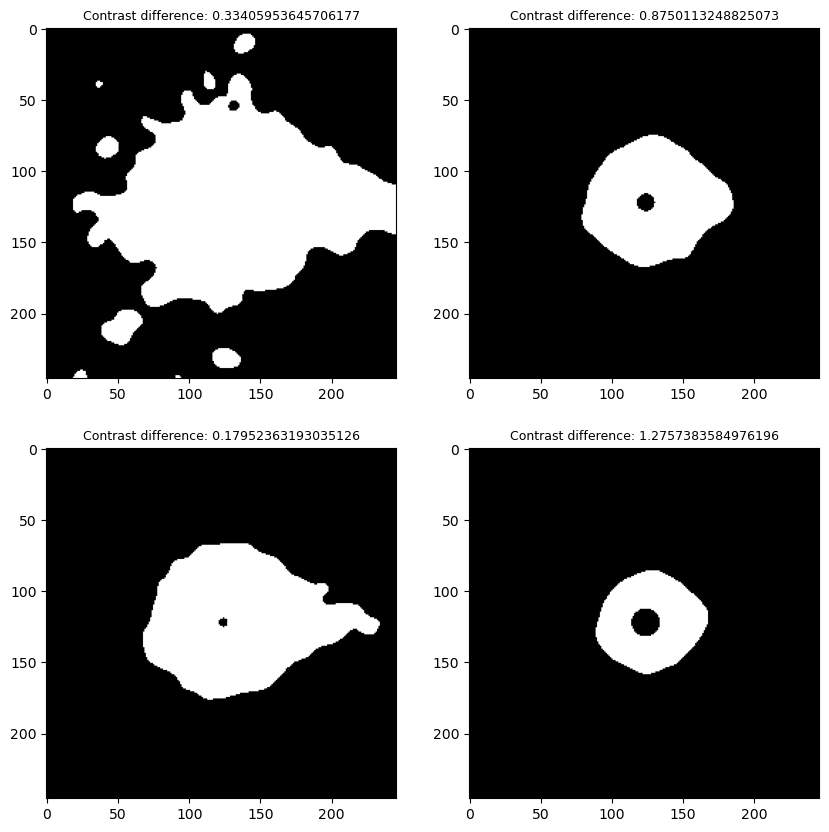

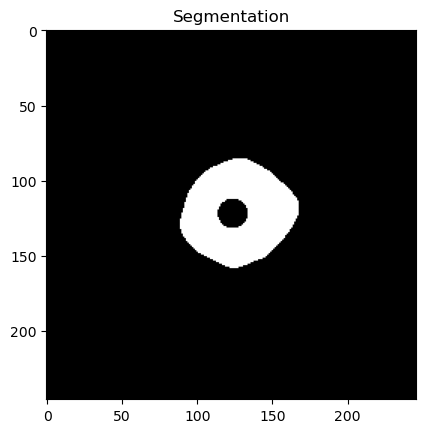

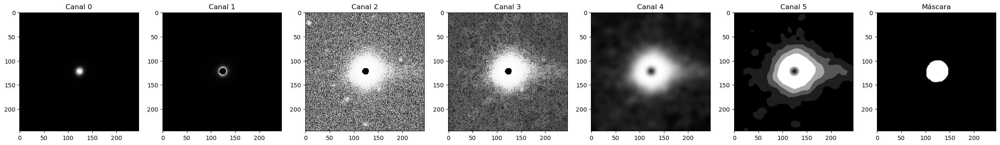

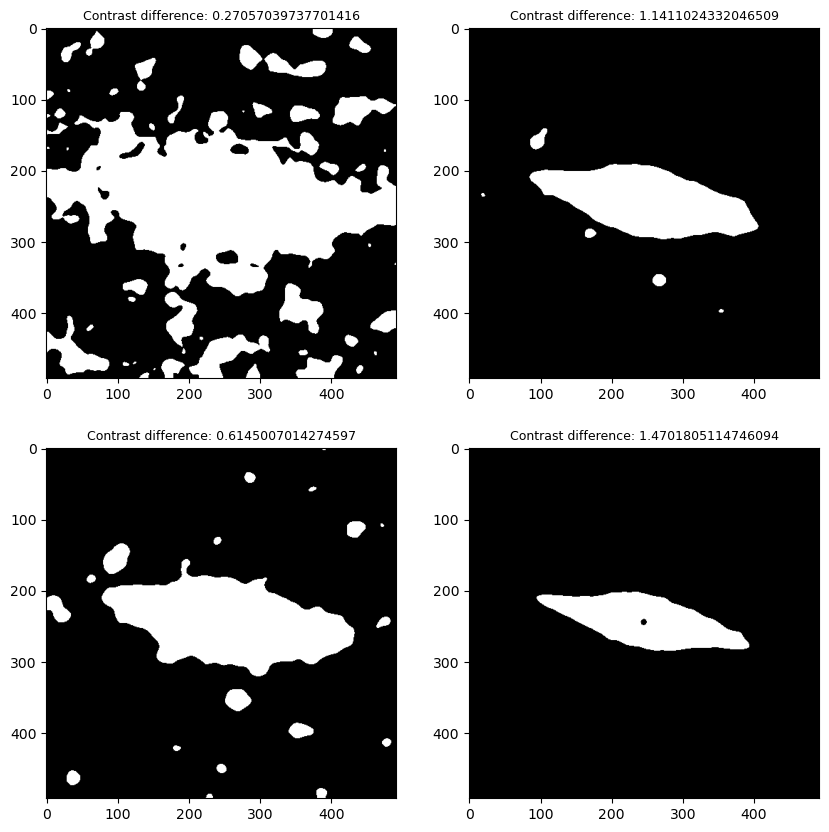

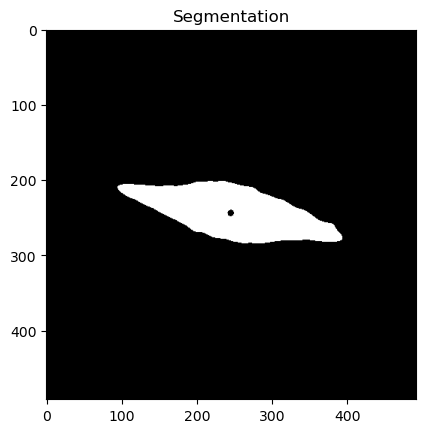

...

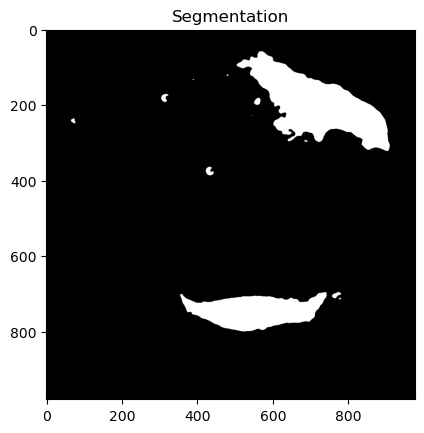

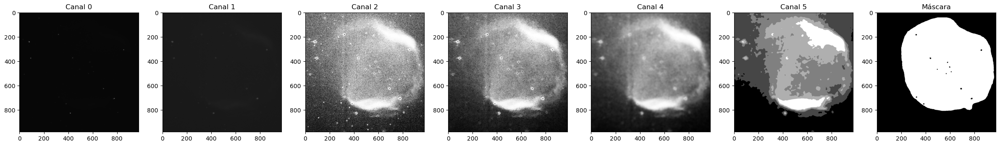

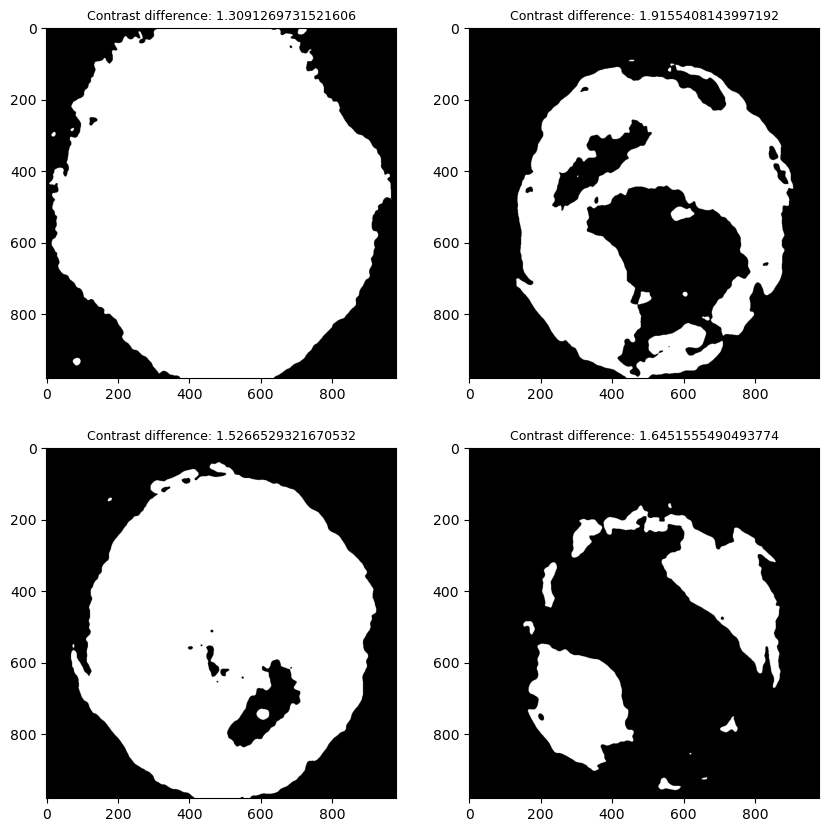

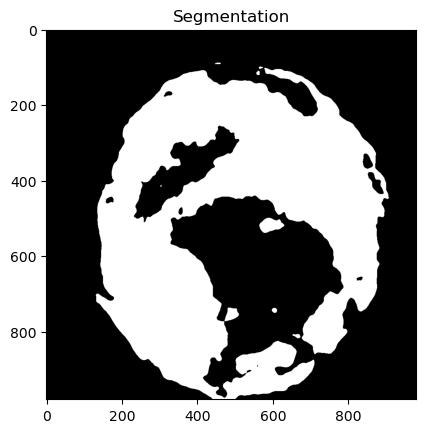

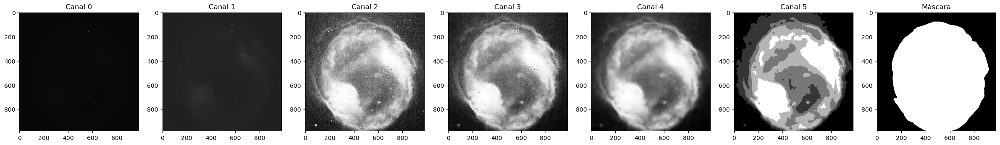

In [51]:
# Celda de código donde se realizan algunas pruebas para comprobar los resultados de la segmentación
# Más adelante se implementa este código en una función que se puede llamar desde el script principal

transform_x = transforms.Compose([
                    MinMaxNorm,
                    ApplyMorphology(operation = morphology.binary_opening, concat = True, footprint = morphology.disk(2)),
                    # ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    ApplyIntensityTransformation(transformation = exposure.equalize_hist, concat = True, nbins = 4096),
                    # ApplyIntensityTransformation(transformation = exposure.equalize_adapthist, concat = True, nbins = 640, kernel_size = 5),
                    ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    ApplyFilter(filter = ndimage.gaussian_filter, concat = True, sigma = 5),
                    ApplyKMeans(concat=True, n_clusters=5, max_iter=10, n_init=10, random_state=42),
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = -1)
                    ])

transform_y = transforms.Compose([
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = 0)
                    ])

# Prueba normalizando los datos entre 0 y 1
df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df, transform = (transform_x, transform_y))

for i in range(50,60):
    image_original, mask = dataset[i]
    image = image_original[-1]
    
    morphology_percentage_alpha = 0.025
    
    # Si se utiliza la imagen original
    # threshold = 1.75
    
    # Si se utiliza la imagen adaptada
    threshold = 2

    # Sort unique cluster values in ascending order
    unique_values = image.unique(sorted=True)

    background = torch.where(image == unique_values[0], torch.tensor(0), torch.tensor(1))
    final_background = background.clone()
    
    fig, ax = plt.subplots(2, (len(unique_values)-1)//2 + (len(unique_values)-1)%2, figsize=(5 * (len(unique_values)-1)//2, 5 * 2))
    cnt = 0
    solution = False
    
    old_metric = -np.inf
    # Mientras que el porcentaje de píxeles de fondo sea menor que el porcentaje mínimo, seguimos añadiendo clusters al fondo
    for cluster_value in unique_values[1:]:
        bg_wo_holes = binary_closing(background, footprint=disk(image_original.shape[1]*morphology_percentage_alpha))
        bg_erosion = binary_erosion(bg_wo_holes, footprint=disk(image_original.shape[1]*morphology_percentage_alpha))

        bg_dilation = binary_dilation(background, disk(image_original.shape[1]*morphology_percentage_alpha*2))

        if sum(bg_erosion.flatten()) >= len(bg_erosion.flatten()) * 0.99 or sum(bg_dilation.flatten()) >= len(bg_dilation.flatten()) * 0.99:
            add_background = torch.where(image == cluster_value, torch.tensor(0), torch.tensor(1))
            background *= add_background
            continue
        elif sum(bg_erosion.flatten()) == 0 or sum(bg_dilation.flatten()) == 0:
            print("No more clusters to add", i)
            break
        
        contour_bg = measure.find_contours(background.numpy())
        contour_bg = max(contour_bg, key=len)
        
        contour_bg_erosion = measure.find_contours(bg_erosion)
        contour_bg_erosion = max(contour_bg_erosion, key=len)
        
        contour_bg_dilation = measure.find_contours(bg_dilation)
        contour_bg_dilation = max(contour_bg_dilation, key=len)
        
        closest_points_erosion = map(lambda x: find_closest_points(x, contour_bg_erosion), contour_bg)
        closest_points_dilation = map(lambda x: find_closest_points(x, contour_bg_dilation), contour_bg)
                
        # Calcular la diferencia entre los contornos erosionados y dilatados
        
        differences_points = []
        
        # ## Valores de KMeans
        # for point_erosion, point_dilation in zip(closest_points_erosion, closest_points_dilation):
        #     value_erosion = image_original.permute(1,2,0).numpy()[int(point_erosion[0]), int(point_erosion[1]), -1]
        #     value_dilation = image.permute(1,2,0).numpy()[int(point_dilation[0]), int(point_dilation[1]), -1]
        #     differences_points.append(value_erosion - value_dilation)
        
        ## Valores de Original
        # for point_erosion, point_dilation in zip(closest_points_erosion, closest_points_dilation):
        #     value_erosion = image_original.permute(1,2,0).numpy()[int(point_erosion[0]), int(point_erosion[1]), 0]
        #     value_dilation = image.permute(1,2,0).numpy()[int(point_dilation[0]), int(point_dilation[1]), 0]
        #     differences_points.append(value_erosion - value_dilation)
        
        # ## Valores de Adaptive Equalization
        for point_erosion, point_dilation in zip(closest_points_erosion, closest_points_dilation):
            value_erosion = image_original.permute(1,2,0).numpy()[int(point_erosion[0]), int(point_erosion[1]), 2]
            value_dilation = image_original.permute(1,2,0).numpy()[int(point_dilation[0]), int(point_dilation[1]), 2]
            differences_points.append(value_erosion - value_dilation)

        # Calcular la media y la desviación típica de los valores de contraste
        mean_difference = np.mean(differences_points)
        std_difference = np.std(differences_points)
    
        j, i = divmod(cnt, 2)
        
        metric = mean_difference / std_difference
        # metric = mean_difference

        ax[i, j].set_title(f"Contrast difference: {metric}", fontsize = 9)
        ax[i, j].imshow(background, cmap = "gray")
        fig.show()
        
        add_background = torch.where(image == cluster_value, torch.tensor(0), torch.tensor(1))
        new_background = background * add_background
        
        if  metric >= threshold and not solution:
            final_background = background.clone()
            solution = True
        
        elif not solution and metric > old_metric:
            old_metric = metric
            final_background = background.clone()
            
        background = new_background
        
        cnt += 1
    
    plt.figure()
    plt.imshow(final_background, cmap = "gray")
    plt.title(f"Segmentation")
    plt.show()
    
    plot_all(image_original, mask, cmap = "gray")

En esta siguiente celda se fusionan la nueva técnica de diferencia de contraste con la primera técnica de porcentaje de fondo de estrellas.

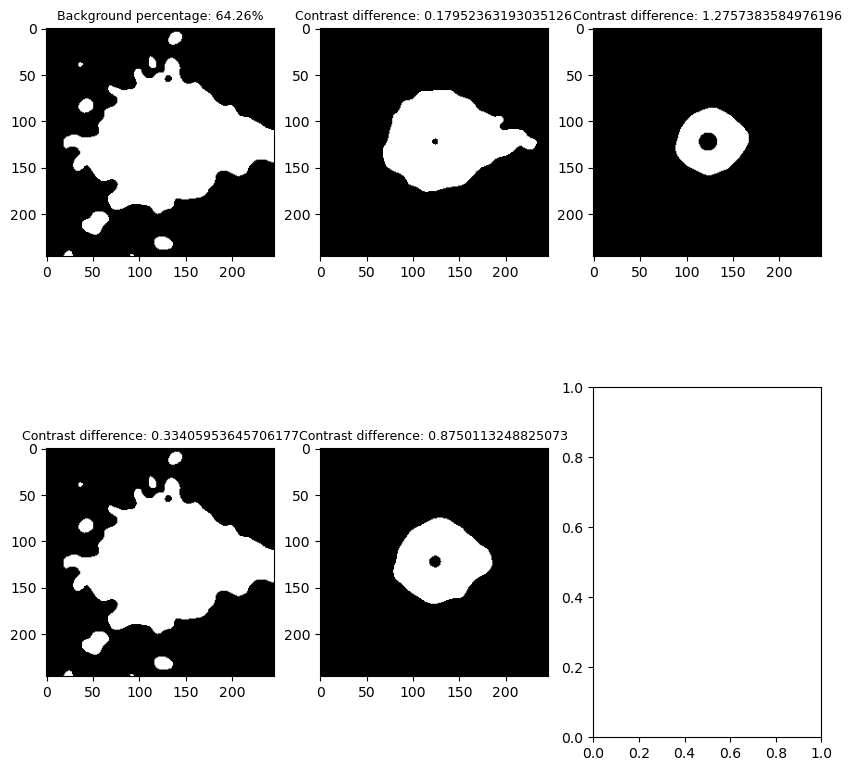

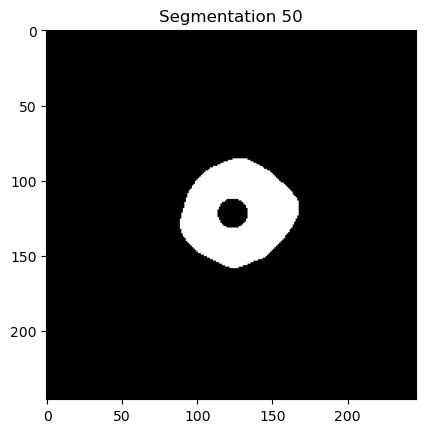

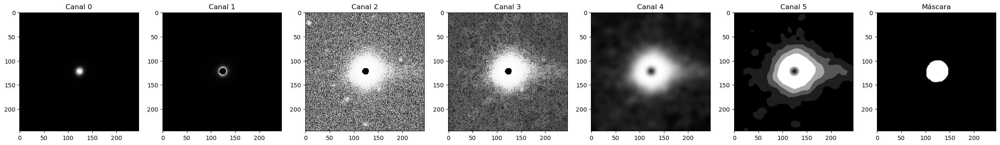

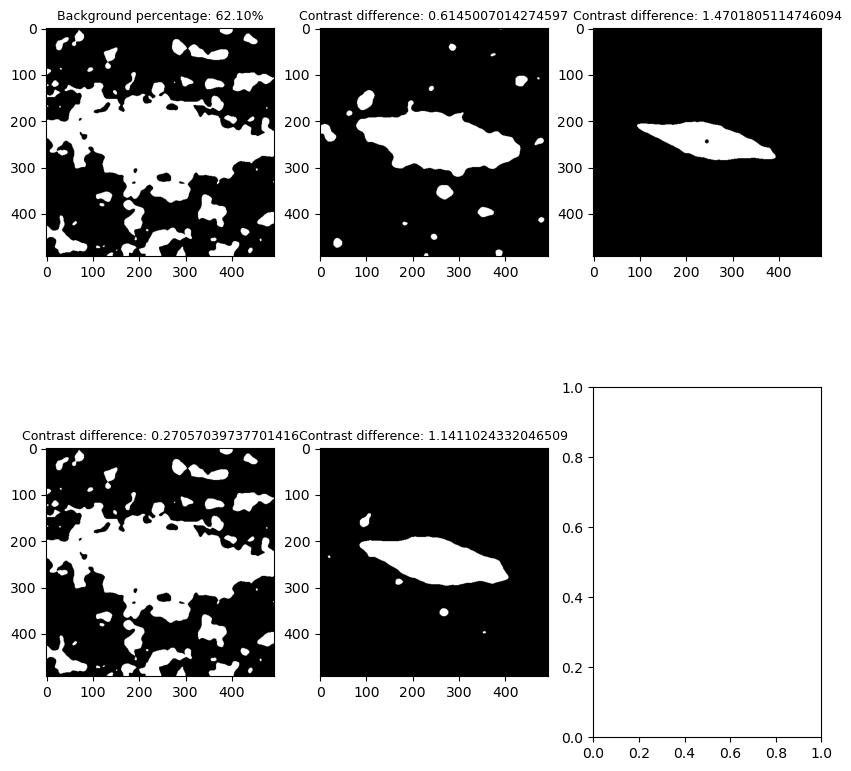

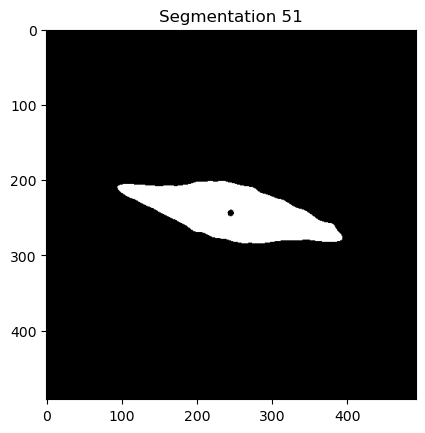

...

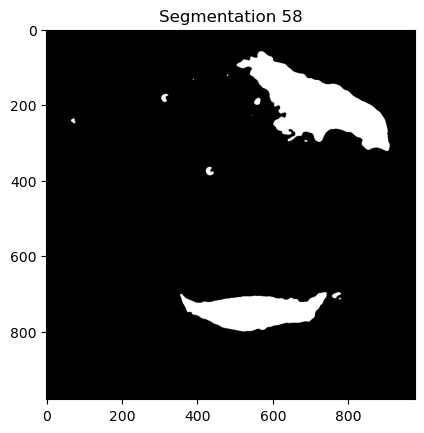

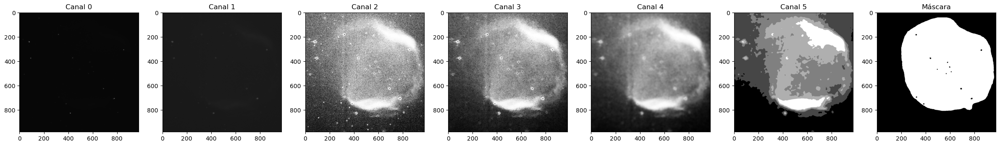

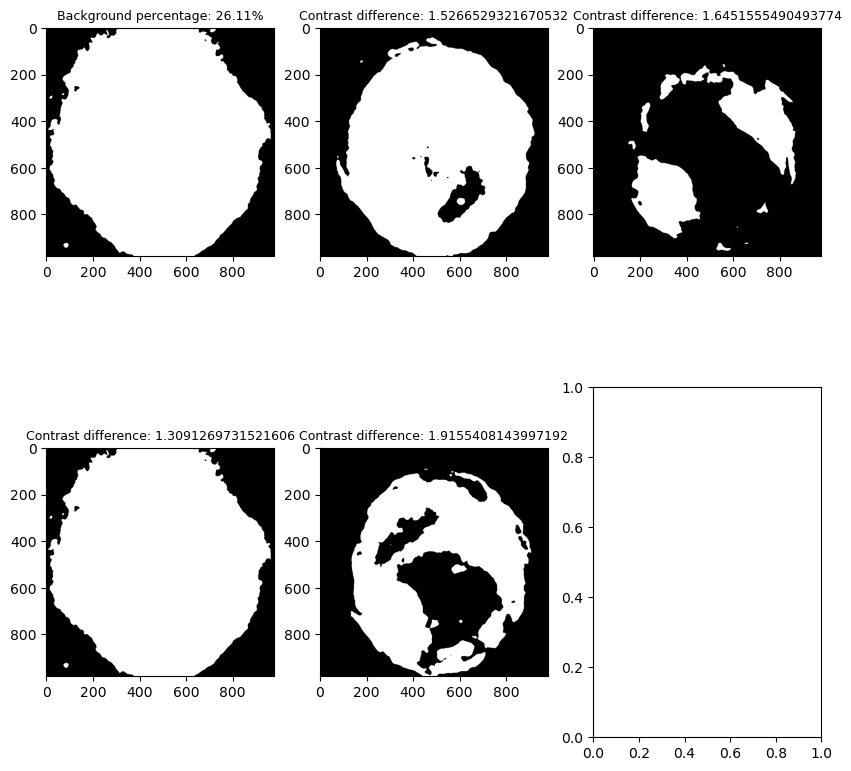

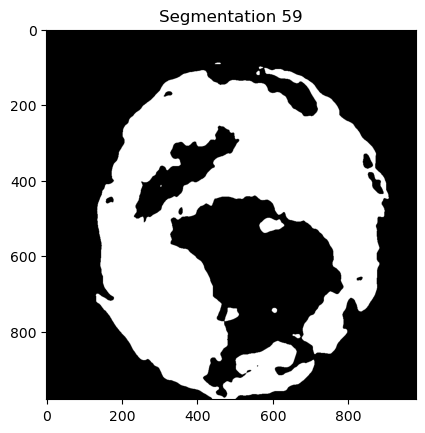

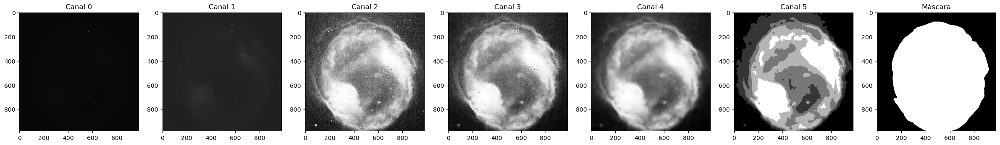

In [52]:
# Celda de código donde se realizan algunas pruebas para comprobar los resultados de la segmentación
# Más adelante se implementa este código en una función que se puede llamar desde el script principal

transform_x = transforms.Compose([
                    MinMaxNorm,
                    ApplyMorphology(operation = morphology.binary_opening, concat = True, footprint = morphology.disk(2)),
                    # ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    ApplyIntensityTransformation(transformation = exposure.equalize_hist, concat = True, nbins = 4096),
                    # ApplyIntensityTransformation(transformation = exposure.equalize_adapthist, concat = True, nbins = 640, kernel_size = 5),
                    ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    ApplyFilter(filter = ndimage.gaussian_filter, concat = True, sigma = 5),
                    ApplyKMeans(concat=True, n_clusters=5, max_iter=10, n_init=10, random_state=42),
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = -1)
                    ])

transform_y = transforms.Compose([
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = 0)
                    ])

# Prueba normalizando los datos entre 0 y 1
df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df, transform = (transform_x, transform_y))

for idx in range(50,60):
    image_original, mask = dataset[idx]
    image = image_original[-1]
    
    morphology_percentage_alpha = 0.025
    
    min_background_percentage = 0.4
    
    # Si se utiliza la imagen adaptada
    threshold = 2

    # Sort unique cluster values in ascending order
    unique_values = image.unique(sorted=True)

    background = torch.where(image == unique_values[0], torch.tensor(0), torch.tensor(1))
    final_background = background.clone()
    
    if len(unique_values) % 2 == 0:
        fig, ax = plt.subplots(2, (len(unique_values)-1)//2 + (len(unique_values)-1)%2, figsize=(5 * (len(unique_values)-1)//2, 5 * 2))
    else:
        fig, ax = plt.subplots(2, (len(unique_values)-1)//2 + (len(unique_values)-1)%2 + 1, figsize=(5 * (len(unique_values)-1)//2, 5 * 2))
    cnt = 0
    solution = False
    
    old_metric = -np.inf
    # Mientras que el porcentaje de píxeles de fondo sea menor que el porcentaje mínimo, seguimos añadiendo clusters al fondo
    
    # Mientras que el porcentaje de píxeles de fondo sea menor que el porcentaje mínimo, seguimos añadiendo clusters al fondo
    for cluster_value in unique_values[1:]:
        j, i = divmod(cnt, 2)
        ax[i, j].set_title(f"Background percentage: {(1 - background.sum() / background.numel())*100:.2f}%", fontsize = 9)
        ax[i, j].imshow(background, cmap = "gray")
        fig.show()
        
        add_background = torch.where(image == cluster_value, torch.tensor(0), torch.tensor(1))
        new_background = background * add_background

        cnt += 1
        if (1 - new_background.sum() / new_background.numel()) > min_background_percentage and not solution:
            final_background = background.clone()
            break
        
        background = new_background
        
    for cluster_value in unique_values[cnt:]:
        bg_wo_holes = binary_closing(background, footprint=disk(image_original.shape[1]*morphology_percentage_alpha))
        bg_erosion = binary_erosion(bg_wo_holes, footprint=disk(image_original.shape[1]*morphology_percentage_alpha))

        bg_dilation = binary_dilation(background, disk(image_original.shape[1]*morphology_percentage_alpha*2))

        if sum(bg_erosion.flatten()) == 0 or sum(bg_dilation.flatten()) == 0:
            print(f"Cluster {cluster_value} has been added to the background")
            break
        
        try:
            contour_bg = measure.find_contours(background.numpy())
            contour_bg = max(contour_bg, key=len)
            
            contour_bg_erosion = measure.find_contours(bg_erosion)
            contour_bg_erosion = max(contour_bg_erosion, key=len)
            
            contour_bg_dilation = measure.find_contours(bg_dilation)
            contour_bg_dilation = max(contour_bg_dilation, key=len)
        except ValueError:
            add_background = torch.where(image == cluster_value, torch.tensor(0), torch.tensor(1))
            background *= add_background
            continue
         
        closest_points_erosion = map(lambda x: find_closest_points(x, contour_bg_erosion), contour_bg)
        closest_points_dilation = map(lambda x: find_closest_points(x, contour_bg_dilation), contour_bg)

        differences_points = []
                
        # Calcular la diferencia entre los contornos erosionados y dilatados
        
        # ## Valores de KMeans
        # for point_erosion, point_dilation in zip(closest_points_erosion, closest_points_dilation):
        #     value_erosion = image_original.permute(1,2,0).numpy()[int(point_erosion[0]), int(point_erosion[1]), -1]
        #     value_dilation = image_original.permute(1,2,0).numpy()[int(point_dilation[0]), int(point_dilation[1]), -1]
        #     differences_points.append(value_erosion - value_dilation)
        
        ## Valores de Original
        # for point_erosion, point_dilation in zip(closest_points_erosion, closest_points_dilation):
        #     value_erosion = image_original.permute(1,2,0).numpy()[int(point_erosion[0]), int(point_erosion[1]), 0]
        #     value_dilation = image_original.permute(1,2,0).numpy()[int(point_dilation[0]), int(point_dilation[1]), 0]
        #     differences_points.append(value_erosion - value_dilation)
        
        # ## Valores de Adaptive Equalization
        for point_erosion, point_dilation in zip(closest_points_erosion, closest_points_dilation):
            value_erosion = image_original.permute(1,2,0).numpy()[int(point_erosion[0]), int(point_erosion[1]), 2]
            value_dilation = image_original.permute(1,2,0).numpy()[int(point_dilation[0]), int(point_dilation[1]), 2]
            differences_points.append(value_erosion - value_dilation)

        # Calcular la media y la desviación típica de los valores de contraste
        mean_difference = np.mean(differences_points)
        std_difference = np.std(differences_points)
        
        j, i = divmod(cnt, 2)

        metric = mean_difference / std_difference
        
        ax[i, j].set_title(f"Contrast difference: {metric}", fontsize = 9)
        ax[i, j].imshow(background, cmap = "gray")
        fig.show()
        
        cnt += 1
        
        add_background = torch.where(image == cluster_value, torch.tensor(0), torch.tensor(1))
        new_background = background * add_background
        
        if  metric >= threshold and not solution:
            final_background = background.clone()
            solution = True
        
        elif not solution and metric > old_metric:
            old_metric = metric
            final_background = background.clone()
            
        background = new_background
    
    plt.figure()
    plt.imshow(final_background, cmap = "gray")
    plt.title(f"Segmentation {idx}")
    plt.show()
    
    plot_all(image_original, mask, cmap = "gray")

Ahora que tenemos una función definida que nos selecciona los primeros clusters convenientes como fondo, vamos a definir una metodología de evaluación y vamos a comprobar que tal funcionan nuestras técnicas combinando diferentes etapas de preprocesado a nuestras imágenes.

In [55]:
import segmentation_models_pytorch as smp
import pandas as pd
from skimage import morphology, exposure
from skimage.morphology import disk, binary_closing, binary_erosion, binary_dilation

results = {"iou": [], "f1": [], "precision": [], "accuracy": [], "recall": []}

transform_x = transforms.Compose([
                    MinMaxNorm,
                    ApplyMorphology(operation = morphology.binary_opening, concat = True, footprint = morphology.disk(2)),
                    # ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    ApplyIntensityTransformation(transformation = exposure.equalize_hist, concat = True, nbins = 4096),
                    # ApplyIntensityTransformation(transformation = exposure.equalize_adapthist, concat = True, nbins = 640, kernel_size = 5),
                    ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    ApplyFilter(filter = ndimage.gaussian_filter, concat = True, sigma = 5),
                    ApplyKMeans(concat=True, n_clusters=5, max_iter=10, n_init=10, random_state=42),
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = -1)
                    ])

transform_y = transforms.Compose([
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = 0)
                    ])

# Prueba normalizando los datos entre 0 y 1
df = pd.read_csv("data_files_1c_train.csv")
dataset = NebulaeDataset(data_directory, masks_directory, df, transform = (transform_x, transform_y))

for i in range(len(dataset)):
    image, mask = dataset[i]
    
    # output = filter_cluster(image, threshold = 0.9).expand_as(mask)
    # output = filter_cluster(image, threshold = 4, morphology_percentage_alpha = 0.025, mode = "contrast_difference", channel_index = 2).expand_as(mask)
    # output = filter_cluster(image, threshold = (0.65, np.inf), morphology_percentage_alpha = 0.025, mode = "mixed", channel_index = 2, metric_fnc = lambda x_mean, x_std, y_mean, y_std: x_mean - y_mean).expand_as(mask)
    output = filter_cluster(image, threshold = np.inf, morphology_percentage_alpha = 0.025, mode = "contrast_difference_np", channel_index = 2, metric_fnc = lambda x_mean, x_std: x_mean/x_std).expand_as(mask)
    # output = filter_cluster(image, threshold = (0.5, 1.5), morphology_percentage_alpha = 0.025, mode = "mixed_np", channel_index = 2, metric_fnc = lambda x_mean, x_std: x_mean/x_std).expand_as(mask)
    
    output = morphology.binary_opening(output.permute(1,2,0).numpy()[:,:,0], footprint=morphology.disk(5))
    output = morphology.remove_small_objects(output, min_size=output.shape[0]*output.shape[1]*0.01)
    output = torch.tensor(output).unsqueeze(0)
    tp, fp, fn, tn = smp.metrics.get_stats(output, mask, mode='binary')
    
    iou_score = smp.metrics.iou_score(tp, fp, fn, tn, reduction="micro")        # Índice de Jaccard
    f1_score = smp.metrics.f1_score(tp, fp, fn, tn, reduction="micro")          # F1-Score
    accuracy = smp.metrics.accuracy(tp, fp, fn, tn, reduction="macro")          # Accuracy
    recall = smp.metrics.recall(tp, fp, fn, tn, reduction="micro-imagewise")    # Sensibilidad
    precision = smp.metrics.precision(tp, fp, fn, tn, reduction="micro")        # Precisión

    results["iou"].append(iou_score)
    results["f1"].append(f1_score)
    results["precision"].append(precision)
    results["accuracy"].append(accuracy)
    results["recall"].append(recall)
    
    # Si descomentamos las siguientes líneas, se mostrarán varias imágenes segmentadas al igual que en la anterior celda de código
    # if i == 59:
    #     plot_all(image, mask, cmap = "gray")
    #     plt.figure()
    #     plt.imshow(output[0], cmap = "gray")
    #     plt.title(f"Segmentation")
    #     plt.show()
    
    # plot_all(image, mask, cmap = "gray")
    # plt.figure()
    # plt.imshow(output[0], cmap = "gray")
    # plt.title(f"Segmentation")
    # plt.show()
    # if i == 10:
    #     break

df_results = pd.DataFrame(results)
print(df_results.astype(float).describe().loc[['mean', 'std']].transpose().to_markdown())

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.601881 | 0.254584  |
| f1        | 0.715364 | 0.231969  |
| precision | 0.711569 | 0.287932  |
| accuracy  | 0.933474 | 0.0908631 |
| recall    | 0.856153 | 0.194249  |


***Resultados de K-Means***

<table>
<tr><td>

***n_cluster = 5, thr = 0.9***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.37508  | 0.310988 |
| f1        | 0.470753 | 0.338142 |
| precision | 0.526198 | 0.371057 |
| accuracy  | 0.871985 | 0.141553 |
| recall    | 0.594187 | 0.36789  |

</td><td>

***n_cluster = 7, thr = 0.9***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.37938  | 0.277665 |
| f1        | 0.491976 | 0.296019 |
| precision | 0.517117 | 0.346185 |
| accuracy  | 0.858096 | 0.137274 |
| recall    | 0.686926 | 0.32084  |

</td><td>

***n_cluster = 9, thr = 0.9***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.373461 | 0.27246  |
| f1        | 0.488062 | 0.287842 |
| precision | 0.493902 | 0.344389 |
| accuracy  | 0.834467 | 0.151213 |
| recall    | 0.742767 | 0.296937 |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = 0.15***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.37508  | 0.310988 |
| f1        | 0.470753 | 0.338142 |
| precision | 0.526198 | 0.371057 |
| accuracy  | 0.871985 | 0.141553 |
| recall    | 0.594187 | 0.36789  |

</td><td>

***n_cluster = 7, thr = 0.15***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.381121 | 0.271178 |
| f1        | 0.495002 | 0.297405 |
| precision | 0.66671  | 0.343352 |
| accuracy  | 0.907091 | 0.119314 |
| recall    | 0.500452 | 0.332899 |

</td><td>

***n_cluster = 9, thr = 0.15***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.387446 | 0.269905 |
| f1        | 0.502708 | 0.293427 |
| precision | 0.684121 | 0.334244 |
| accuracy  | 0.903097 | 0.132654 |
| recall    | 0.501387 | 0.330321 |

</td></tr> </table>

***Resultados de K-Means con adaptación del histograma***

<table>
<tr><td>

***n_cluster = 5, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.329953 | 0.219376  |
| f1        | 0.458594 | 0.233501  |
| precision | 0.378143 | 0.260013  |
| accuracy  | 0.840805 | 0.0694152 |
| recall    | 0.864319 | 0.195416  |

</td><td>

***n_cluster = 7, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.3736   | 0.226978  |
| f1        | 0.50645  | 0.232481  |
| precision | 0.463247 | 0.290567  |
| accuracy  | 0.880065 | 0.0694132 |
| recall    | 0.807421 | 0.228194  |

</td><td>

***n_cluster = 9, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.379375 | 0.216467  |
| f1        | 0.516047 | 0.221726  |
| precision | 0.501719 | 0.293986  |
| accuracy  | 0.89134  | 0.0716482 |
| recall    | 0.766519 | 0.256786  |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = 4***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.212555 | 0.2354   |
| f1        | 0.299862 | 0.267216 |
| precision | 0.236225 | 0.268792 |
| accuracy  | 0.430053 | 0.298962 |
| recall    | 0.939265 | 0.153699 |

</td><td>

***n_cluster = 7, thr = 4***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.279352 | 0.276323 |
| f1        | 0.37191  | 0.306333 |
| precision | 0.319982 | 0.319089 |
| accuracy  | 0.517837 | 0.361533 |
| recall    | 0.915578 | 0.183357 |

</td><td>

***n_cluster = 9, thr = 4***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.324391 | 0.283189 |
| f1        | 0.424057 | 0.314258 |
| precision | 0.399535 | 0.342193 |
| accuracy  | 0.603805 | 0.37807  |
| recall    | 0.867784 | 0.235727 |

</td></tr> </table>

***Resultados de K-Means con opening en área***

<table>
<tr><td>

***n_cluster = 5, thr = 0.9***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.466961 | 0.316024 |
| f1        | 0.568818 | 0.321267 |
| precision | 0.58336  | 0.381781 |
| accuracy  | 0.791326 | 0.245404 |
| recall    | 0.840649 | 0.205996 |

</td><td>

***n_cluster = 7, thr = 0.9***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.437095 | 0.302629 |
| f1        | 0.544164 | 0.311046 |
| precision | 0.546452 | 0.373229 |
| accuracy  | 0.794082 | 0.228168 |
| recall    | 0.849382 | 0.210821 |

</td><td>

***n_cluster = 9, thr = 0.9***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.435648 | 0.28029  |
| f1        | 0.551791 | 0.288742 |
| precision | 0.545646 | 0.352221 |
| accuracy  | 0.836415 | 0.177042 |
| recall    | 0.845654 | 0.220264 |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = 0.15***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.47617  | 0.28749  |
| f1        | 0.589208 | 0.293509 |
| precision | 0.758542 | 0.304379 |
| accuracy  | 0.888149 | 0.170112 |
| recall    | 0.642865 | 0.320125 |

</td><td>

***n_cluster = 7, thr = 0.15***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.496173 | 0.2674   |
| f1        | 0.617519 | 0.261463 |
| precision | 0.741683 | 0.289696 |
| accuracy  | 0.893495 | 0.147852 |
| recall    | 0.697095 | 0.303034 |

</td><td>

***n_cluster = 9, thr = 0.15***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.467138 | 0.270438 |
| f1        | 0.588296 | 0.269364 |
| precision | 0.686381 | 0.307486 |
| accuracy  | 0.867835 | 0.180333 |
| recall    | 0.721239 | 0.303885 |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = (0.55, 0.15)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.470268 | 0.259941  |
| f1        | 0.593488 | 0.267759  |
| precision | 0.821732 | 0.258552  |
| accuracy  | 0.930975 | 0.0849016 |
| recall    | 0.552602 | 0.294031  |

</td><td>

***n_cluster = 7, thr = (0.55, 0.15)***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.516054 | 0.259652 |
| f1        | 0.638591 | 0.252142 |
| precision | 0.8058   | 0.249817 |
| accuracy  | 0.923359 | 0.101765 |
| recall    | 0.644009 | 0.288695 |

</td><td>

***n_cluster = 9, thr = (0.55, 0.15)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.527279 | 0.26668   |
| f1        | 0.647046 | 0.25436   |
| precision | 0.800134 | 0.236634  |
| accuracy  | 0.931317 | 0.0882969 |
| recall    | 0.653493 | 0.296856  |

</td></tr> </table>

***Resultados de K-Means con opening en área y adaptación del histograma***

<table>
<tr><td>

***n_cluster = 5, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.366814 | 0.234242  |
| f1        | 0.495509 | 0.246272  |
| precision | 0.41137  | 0.281828  |
| accuracy  | 0.857731 | 0.0623562 |
| recall    | 0.912483 | 0.162955  |

</td><td>

***n_cluster = 7, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.426435 | 0.236964  |
| f1        | 0.558927 | 0.239999  |
| precision | 0.515331 | 0.304941  |
| accuracy  | 0.898406 | 0.0620658 |
| recall    | 0.863652 | 0.2081    |

</td><td>

***n_cluster = 9, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.430066 | 0.235226  |
| f1        | 0.563247 | 0.237828  |
| precision | 0.552    | 0.314601  |
| accuracy  | 0.900502 | 0.0697516 |
| recall    | 0.827496 | 0.236046  |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = 5.5***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.364015 | 0.232648  |
| f1        | 0.492988 | 0.244643  |
| precision | 0.405459 | 0.276293  |
| accuracy  | 0.855702 | 0.0629092 |
| recall    | 0.915662 | 0.161278  |

</td><td>

***n_cluster = 7, thr = 5.5***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.422041 | 0.237965  |
| f1        | 0.553933 | 0.242238  |
| precision | 0.494663 | 0.292896  |
| accuracy  | 0.89217  | 0.0675899 |
| recall    | 0.881992 | 0.20115   |

</td><td>

***n_cluster = 9, thr = 5.5***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.455908 | 0.240996 |
| f1        | 0.587775 | 0.238076 |
| precision | 0.545496 | 0.294294 |
| accuracy  | 0.905498 | 0.072804 |
| recall    | 0.86566  | 0.217414 |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = (0.55, 5.5)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.364015 | 0.232648  |
| f1        | 0.492988 | 0.244643  |
| precision | 0.405459 | 0.276293  |
| accuracy  | 0.855702 | 0.0629092 |
| recall    | 0.915662 | 0.161278  |

</td><td>

***n_cluster = 7, thr = (0.55, 5.5)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.422041 | 0.237965  |
| f1        | 0.553933 | 0.242238  |
| precision | 0.494663 | 0.292896  |
| accuracy  | 0.89217  | 0.0675899 |
| recall    | 0.881992 | 0.20115   |

</td><td>

***n_cluster = 9, thr = (0.55, 5.5)***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.455908 | 0.240996 |
| f1        | 0.587775 | 0.238077 |
| precision | 0.545496 | 0.294294 |
| accuracy  | 0.905498 | 0.072804 |
| recall    | 0.865661 | 0.217414 |

</td></tr> </table>

***Resultados de K-Means con adaptación del histograma y opening en área***

<table>
<tr><td>

***n_cluster = 5, thr = 0.9***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.403988 | 0.271232 |
| f1        | 0.523264 | 0.276012 |
| precision | 0.473825 | 0.323125 |
| accuracy  | 0.85782  | 0.118012 |
| recall    | 0.884983 | 0.198739 |

</td><td>

***n_cluster = 7, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.431146 | 0.252807  |
| f1        | 0.559225 | 0.250759  |
| precision | 0.531077 | 0.323561  |
| accuracy  | 0.894384 | 0.0714497 |
| recall    | 0.851492 | 0.213887  |

</td><td>

***n_cluster = 9, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.427454 | 0.239751  |
| f1        | 0.559403 | 0.240869  |
| precision | 0.532583 | 0.317594  |
| accuracy  | 0.895052 | 0.0813936 |
| recall    | 0.846849 | 0.218041  |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = 4***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.503469 | 0.239172  |
| f1        | 0.633867 | 0.230727  |
| precision | 0.590532 | 0.269058  |
| accuracy  | 0.919786 | 0.0743659 |
| recall    | 0.86246  | 0.221071  |

</td><td>

***n_cluster = 7, thr = 4***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.516035 | 0.244377  |
| f1        | 0.644256 | 0.231568  |
| precision | 0.623593 | 0.260032  |
| accuracy  | 0.923491 | 0.0805325 |
| recall    | 0.841565 | 0.253021  |

</td><td>

***n_cluster = 9, thr = 4***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.521741 | 0.245937 |
| f1        | 0.648643 | 0.23485  |
| precision | 0.638688 | 0.252268 |
| accuracy  | 0.923491 | 0.084854 |
| recall    | 0.82634  | 0.271972 |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = (0.55, 4)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.509192 | 0.238211  |
| f1        | 0.639442 | 0.229132  |
| precision | 0.596263 | 0.266328  |
| accuracy  | 0.922261 | 0.0725493 |
| recall    | 0.862447 | 0.221063  |

</td><td>

***n_cluster = 7, thr = (0.55, 4)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.521261 | 0.242243  |
| f1        | 0.64965  | 0.2289    |
| precision | 0.62882  | 0.25582   |
| accuracy  | 0.925757 | 0.0787556 |
| recall    | 0.841563 | 0.25302   |

</td><td>

***n_cluster = 9, thr = (0.55, 4)***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.523938 | 0.245752 |
| f1        | 0.650629 | 0.234787 |
| precision | 0.640887 | 0.251057 |
| accuracy  | 0.925524 | 0.081144 |
| recall    | 0.82634  | 0.271972 |

</td></tr> </table>

***Resultados de K-Means con opening binario y opening en área***

<table>
<tr><td>

***n_cluster = 5, thr = 0.9***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.44948  | 0.319225 |
| f1        | 0.549414 | 0.327739 |
| precision | 0.552659 | 0.387136 |
| accuracy  | 0.766136 | 0.261369 |
| recall    | 0.848807 | 0.187286 |

</td><td>

***n_cluster = 7, thr = 0.9***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.409734 | 0.299737 |
| f1        | 0.51635  | 0.312149 |
| precision | 0.513557 | 0.374204 |
| accuracy  | 0.782785 | 0.228558 |
| recall    | 0.839437 | 0.205546 |

</td><td>

***n_cluster = 9, thr = 0.9***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.407926 | 0.285011 |
| f1        | 0.520756 | 0.296553 |
| precision | 0.513295 | 0.365926 |
| accuracy  | 0.817143 | 0.185592 |
| recall    | 0.837564 | 0.202113 |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = 0.12***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.480269 | 0.251683 |
| f1        | 0.605963 | 0.25866  |
| precision | 0.796796 | 0.292042 |
| accuracy  | 0.905097 | 0.134202 |
| recall    | 0.613967 | 0.282978 |

</td><td>

***n_cluster = 7, thr = 0.12***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.4511   | 0.269251 |
| f1        | 0.571123 | 0.279207 |
| precision | 0.737256 | 0.340926 |
| accuracy  | 0.863539 | 0.18396  |
| recall    | 0.65513  | 0.287908 |

</td><td>

***n_cluster = 9, thr = 0.12***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.443115 | 0.271569 |
| f1        | 0.562811 | 0.278377 |
| precision | 0.719514 | 0.340799 |
| accuracy  | 0.857256 | 0.198408 |
| recall    | 0.665295 | 0.299976 |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = (0.55, 0.12)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.471002 | 0.235259  |
| f1        | 0.602188 | 0.244862  |
| precision | 0.844119 | 0.247541  |
| accuracy  | 0.928854 | 0.0878916 |
| recall    | 0.545742 | 0.263369  |

</td><td>

***n_cluster = 7, thr = (0.55, 0.12)***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.514607 | 0.251298 |
| f1        | 0.639647 | 0.246445 |
| precision | 0.845964 | 0.243531 |
| accuracy  | 0.9311   | 0.087824 |
| recall    | 0.606689 | 0.270961 |

</td><td>

***n_cluster = 9, thr = (0.55, 0.12)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.487774 | 0.261538  |
| f1        | 0.610658 | 0.261961  |
| precision | 0.839577 | 0.238892  |
| accuracy  | 0.932772 | 0.0817437 |
| recall    | 0.576532 | 0.294038  |

</td></tr> </table>

***Resultados de K-Means con opening binario, adaptación del histograma y opening en área***

<table>
<tr><td>

***n_cluster = 5, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.403688 | 0.269487  |
| f1        | 0.523148 | 0.277046  |
| precision | 0.472096 | 0.323891  |
| accuracy  | 0.862288 | 0.0929032 |
| recall    | 0.874314 | 0.188643  |

</td><td>

***n_cluster = 7, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.421668 | 0.255373  |
| f1        | 0.548201 | 0.256392  |
| precision | 0.517183 | 0.330357  |
| accuracy  | 0.889085 | 0.0711154 |
| recall    | 0.844047 | 0.199222  |

</td><td>

***n_cluster = 9, thr = 0.9***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.4281   | 0.245585 |
| f1        | 0.557584 | 0.249809 |
| precision | 0.531236 | 0.324988 |
| accuracy  | 0.895922 | 0.067397 |
| recall    | 0.835976 | 0.204076 |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = 4***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.505129 | 0.240752  |
| f1        | 0.635055 | 0.231245  |
| precision | 0.588794 | 0.276478  |
| accuracy  | 0.91976  | 0.0724055 |
| recall    | 0.856167 | 0.200755  |

</td><td>

***n_cluster = 7, thr = 4***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.511137 | 0.245985  |
| f1        | 0.639292 | 0.233336  |
| precision | 0.622196 | 0.268532  |
| accuracy  | 0.92189  | 0.0807499 |
| recall    | 0.82849  | 0.242515  |

</td><td>

***n_cluster = 9, thr = 4***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.517705 | 0.239986  |
| f1        | 0.647457 | 0.224639  |
| precision | 0.639156 | 0.258985  |
| accuracy  | 0.922726 | 0.0854614 |
| recall    | 0.815989 | 0.250859  |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = (0.65, 4)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.507294 | 0.239792  |
| f1        | 0.637226 | 0.230811  |
| precision | 0.594358 | 0.277646  |
| accuracy  | 0.921729 | 0.0693865 |
| recall    | 0.852715 | 0.201459  |

</td><td>

***n_cluster = 7, thr = (0.65, 4)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.515322 | 0.248188  |
| f1        | 0.642522 | 0.234619  |
| precision | 0.626839 | 0.269367  |
| accuracy  | 0.924373 | 0.0786478 |
| recall    | 0.828008 | 0.242222  |

</td><td>

***n_cluster = 9, thr = (0.65, 4)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.52266  | 0.243141  |
| f1        | 0.651126 | 0.226444  |
| precision | 0.644472 | 0.259903  |
| accuracy  | 0.925943 | 0.0821269 |
| recall    | 0.815534 | 0.250551  |

</td></tr> </table>

***Resultados de K-Means con opening binario, adaptación del histograma y filtro gaussiano***

<table>
<tr><td>

***n_cluster = 5, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.439304 | 0.267478  |
| f1        | 0.561607 | 0.268667  |
| precision | 0.519243 | 0.337516  |
| accuracy  | 0.886519 | 0.0835447 |
| recall    | 0.880513 | 0.182803  |

</td><td>

***n_cluster = 7, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.442616 | 0.248695  |
| f1        | 0.571792 | 0.248598  |
| precision | 0.54247  | 0.328154  |
| accuracy  | 0.899054 | 0.0688364 |
| recall    | 0.85551  | 0.20411   |

</td><td>

***n_cluster = 9, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.460245 | 0.259339  |
| f1        | 0.586274 | 0.254077  |
| precision | 0.55229  | 0.324055  |
| accuracy  | 0.906297 | 0.0667512 |
| recall    | 0.864845 | 0.203059  |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = 4***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.53274  | 0.256116  |
| f1        | 0.655861 | 0.240492  |
| precision | 0.635224 | 0.284071  |
| accuracy  | 0.92092  | 0.0798928 |
| recall    | 0.844594 | 0.231141  |

</td><td>

***n_cluster = 7, thr = 4***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.5145   | 0.256973  |
| f1        | 0.638725 | 0.245708  |
| precision | 0.624083 | 0.284925  |
| accuracy  | 0.913745 | 0.0898197 |
| recall    | 0.832005 | 0.248399  |

</td><td>

***n_cluster = 9, thr = 4***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.491386 | 0.254543  |
| f1        | 0.617762 | 0.247126  |
| precision | 0.595505 | 0.285874  |
| accuracy  | 0.908048 | 0.0953861 |
| recall    | 0.843393 | 0.253043  |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = (0.65, 4)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.538331 | 0.257307  |
| f1        | 0.66035  | 0.241713  |
| precision | 0.643506 | 0.285101  |
| accuracy  | 0.924479 | 0.0762893 |
| recall    | 0.841876 | 0.231006  |

</td><td>

***n_cluster = 7, thr = (0.65, 4)***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.521978 | 0.259335 |
| f1        | 0.644736 | 0.247525 |
| precision | 0.632227 | 0.284862 |
| accuracy  | 0.91846  | 0.085878 |
| recall    | 0.831241 | 0.247966 |

</td><td>

***n_cluster = 9, thr = (0.65, 4)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.498864 | 0.256407  |
| f1        | 0.624215 | 0.248056  |
| precision | 0.603061 | 0.284879  |
| accuracy  | 0.914257 | 0.0852596 |
| recall    | 0.843302 | 0.252987  |

</td></tr> </table>

***Resultados de K-Means con opening binario, adaptación del histograma, opening en área y filtro gaussiano***

<table>
<tr><td>

***n_cluster = 5, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.442468 | 0.273257  |
| f1        | 0.562844 | 0.273448  |
| precision | 0.517199 | 0.33866   |
| accuracy  | 0.88291  | 0.0890026 |
| recall    | 0.894576 | 0.177038  |

</td><td>

***n_cluster = 7, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.458549 | 0.254542  |
| f1        | 0.585957 | 0.251213  |
| precision | 0.556418 | 0.329087  |
| accuracy  | 0.905191 | 0.0667008 |
| recall    | 0.863696 | 0.199125  |

</td><td>

***n_cluster = 9, thr = 0.9***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.473866 | 0.265412  |
| f1        | 0.597354 | 0.259828  |
| precision | 0.564922 | 0.324678  |
| accuracy  | 0.90731  | 0.0705646 |
| recall    | 0.87189  | 0.204135  |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 5, thr = 4***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.54875  | 0.255393  |
| f1        | 0.670053 | 0.238978  |
| precision | 0.65201  | 0.282672  |
| accuracy  | 0.92435  | 0.0803508 |
| recall    | 0.850475 | 0.226154  |

</td><td>

***n_cluster = 7, thr = 4***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.519252 | 0.250733  |
| f1        | 0.644987 | 0.239251  |
| precision | 0.623902 | 0.28002   |
| accuracy  | 0.917253 | 0.0862369 |
| recall    | 0.844226 | 0.238982  |

</td><td>

***n_cluster = 9, thr = 4***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.493332 | 0.25138   |
| f1        | 0.620725 | 0.243213  |
| precision | 0.598352 | 0.279956  |
| accuracy  | 0.908903 | 0.0960365 |
| recall    | 0.846782 | 0.257608  |

</td></tr> </table>

<table>
<tr><td>

***n_cluster = 3, thr = (0.65, 4)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.520183 | 0.268674  |
| f1        | 0.63865  | 0.265517  |
| precision | 0.588133 | 0.288459  |
| accuracy  | 0.916602 | 0.0813341 |
| recall    | 0.889758 | 0.21803   |

</td><td>

***n_cluster = 4, thr = (0.65, 4)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.564262 | 0.258008  |
| f1        | 0.682637 | 0.240793  |
| precision | 0.657234 | 0.291027  |
| accuracy  | 0.931002 | 0.0739002 |
| recall    | 0.8649   | 0.201346  |

</td><td>

***n_cluster = 5, thr = (0.65, 4)***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.553248 | 0.255591 |
| f1        | 0.673791 | 0.239446 |
| precision | 0.660005 | 0.283073 |
| accuracy  | 0.927616 | 0.076626 |
| recall    | 0.846955 | 0.226735 |

</td><td>

***n_cluster = 7, thr = (0.65, 4)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.526322 | 0.252674  |
| f1        | 0.650724 | 0.240741  |
| precision | 0.631776 | 0.280007  |
| accuracy  | 0.921784 | 0.0819894 |
| recall    | 0.84339  | 0.238578  |

</td><td>

***n_cluster = 9, thr = (0.65, 4)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.500896 | 0.252935  |
| f1        | 0.627323 | 0.243932  |
| precision | 0.605957 | 0.278533  |
| accuracy  | 0.915377 | 0.0848575 |
| recall    | 0.846734 | 0.25758   |

</td></tr> </table>



***Resultados de K-Means con opening binario, adaptación del histograma, opening en área y filtro gaussiano + Postprocesado sencillo***

<table>
<tr><td>

***mixed(n_cluster = 5, thr = (0.65, 4))***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.587988 | 0.262025  |
| f1        | 0.701502 | 0.241884  |
| precision | 0.689668 | 0.293589  |
| accuracy  | 0.935116 | 0.0735354 |
| recall    | 0.862482 | 0.205178  |

</td><td>

***contrast_difference_np(n_cluster = 5, thr =  1.5)***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.596073 | 0.257411 |
| f1        | 0.710282 | 0.231871 |
| precision | 0.698666 | 0.293502 |
| accuracy  | 0.92779  | 0.103925 |
| recall    | 0.865905 | 0.184    |

</td><td>

***contrast_difference_np(n_cluster = 5, thr =  inf)***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.600764 | 0.255726  |
| f1        | 0.714531 | 0.230437  |
| precision | 0.703358 | 0.290356  |
| accuracy  | 0.931269 | 0.0983131 |
| recall    | 0.865905 | 0.184     |

</td><td>

***mixed_np(n_cluster = 5, thr = (0.65, 1.5))***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.602262 | 0.252247  |
| f1        | 0.716911 | 0.226011  |
| precision | 0.709016 | 0.287877  |
| accuracy  | 0.936888 | 0.0724494 |
| recall    | 0.860877 | 0.184348  |

</td><td>

***mixed_np(n_cluster = 5, thr = (0.65, inf))***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.60079  | 0.253153  |
| f1        | 0.715433 | 0.22709   |
| precision | 0.714689 | 0.287114  |
| accuracy  | 0.936447 | 0.0775219 |
| recall    | 0.85372  | 0.193127  |

</td></tr>
</td><td>

***mixed_np(n_cluster = 5, thr = (0.4, inf))***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.605043 | 0.251604  |
| f1        | 0.719286 | 0.225607  |
| precision | 0.708453 | 0.284967  |
| accuracy  | 0.93777  | 0.0713631 |
| recall    | 0.864226 | 0.183584  |

</td><td>

***mixed_np(n_cluster = 7, thr = (0.4, inf))***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.614432 | 0.254341  |
| f1        | 0.725376 | 0.23254   |
| precision | 0.743266 | 0.277622  |
| accuracy  | 0.941151 | 0.0866822 |
| recall    | 0.827825 | 0.209414  |

</td></tr> </table>



### Fuzzy C-Means (FCM)
Vamos a continuar probando una de las variantes del algoritmo de KMeans. Este algoritmo se diferencia del anterior en que, en vez de aportar un cluster al que pertenece cada cluster, aporta un nivel de pertenencia entre 0 y 1.

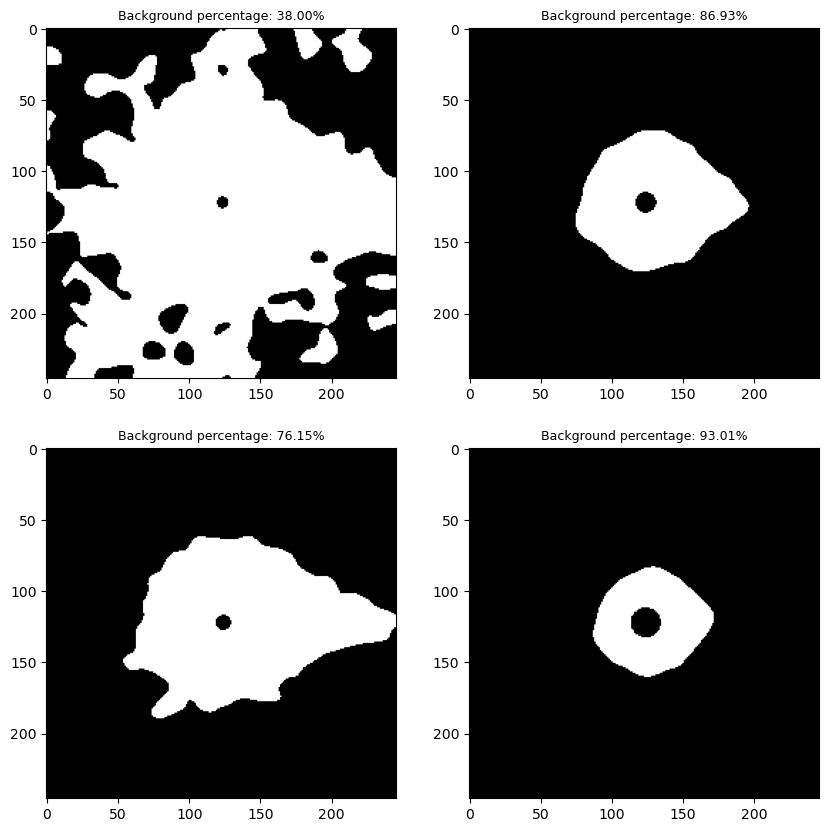

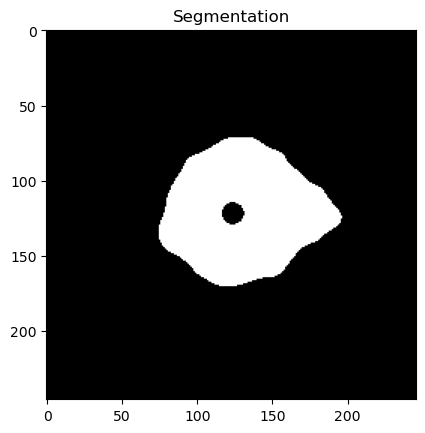

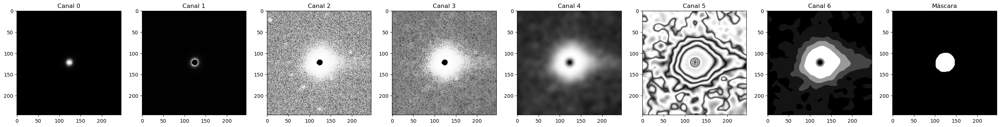

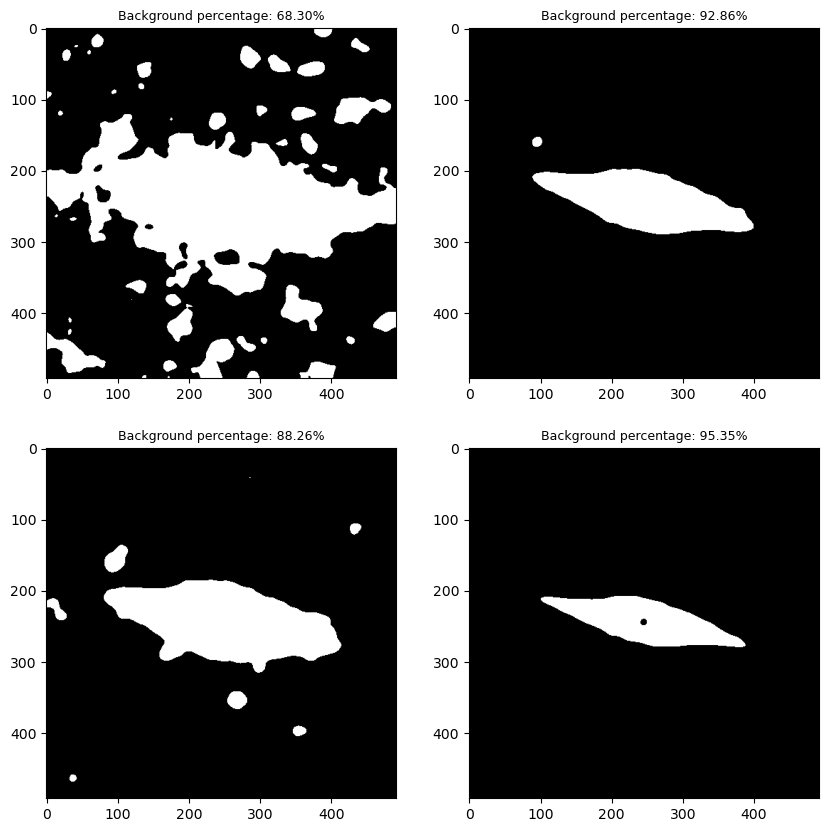

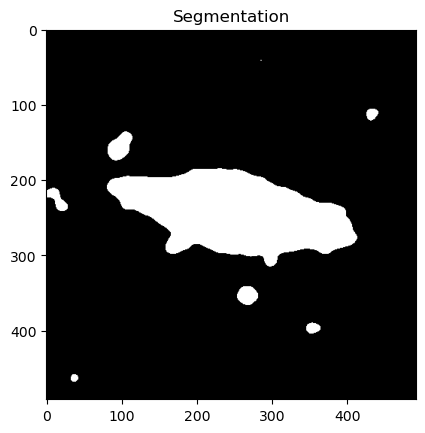

...

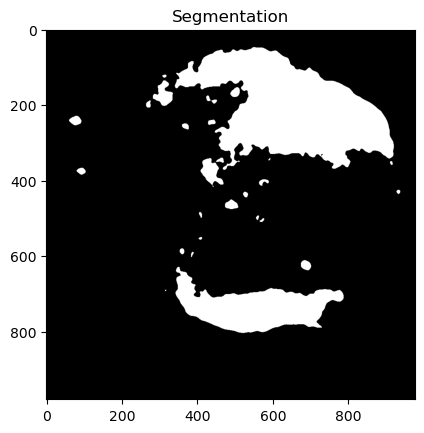

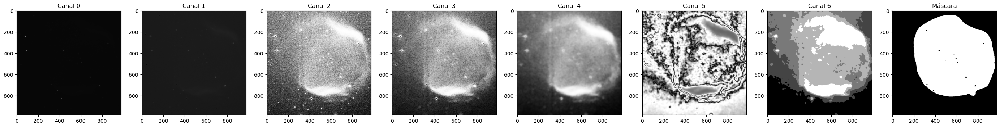

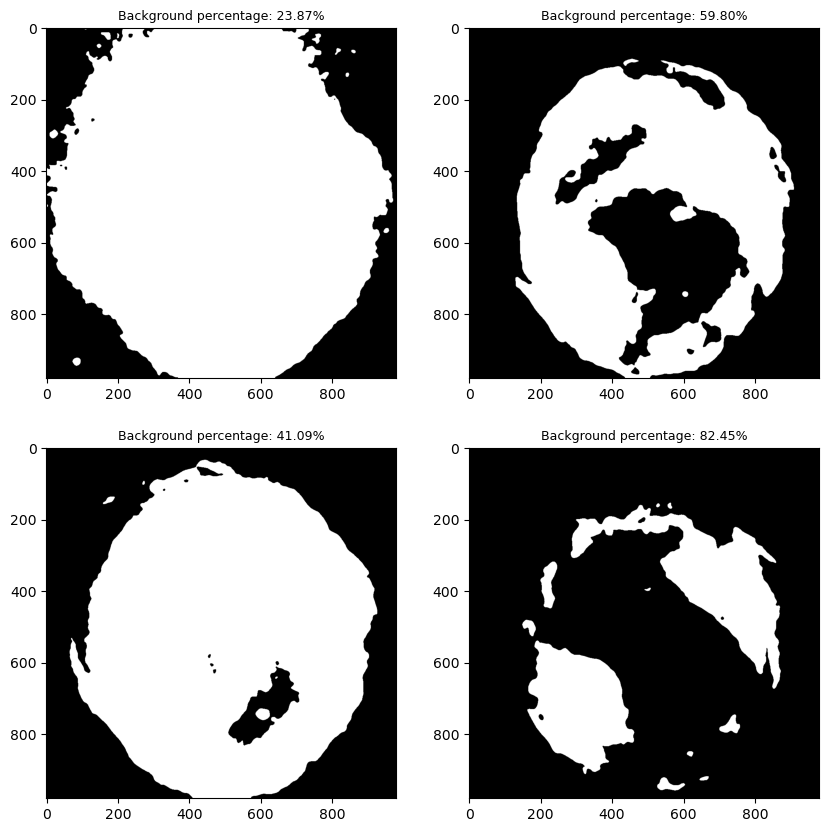

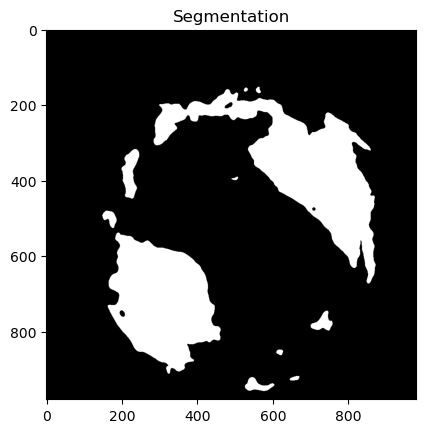

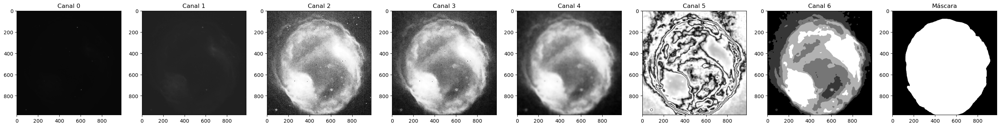

In [56]:
# CELDA PARA MOSTRAR LA SEGMENTACIÓN PASO A PASO Y LAS TRANSFORMACIONES APLICADAS (Ejecutar si se quiere observar el proceso paso a paso)
threshold = None
# threshold = 0.25

transform_x = transforms.Compose([
                    MinMaxNorm,
                    ApplyMorphology(operation = morphology.binary_opening, concat = True, footprint = morphology.disk(2)),
                    # ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 100, connectivity = 1),
                    ApplyIntensityTransformation(transformation = exposure.equalize_hist, concat = True, nbins = 640),
                    # ApplyIntensityTransformation(transformation = exposure.equalize_adapthist, concat = True, nbins = 640, kernel_size = 4),
                    ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    ApplyFilter(filter = ndimage.gaussian_filter, concat = True, sigma = 5),
                    ApplyFCM(concat=True, c=5, m=2, error = 0.005, maxiter=15, seed=42),
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = -1)
                    ])

transform_y = transforms.Compose([
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = 0)
                    ])

df = pd.read_csv("data_files_1c_train.csv")
# Prueba normalizando los datos entre 0 y 1
dataset = NebulaeDataset(data_directory, masks_directory, df, transform = (transform_x, transform_y))

for i in range(50,60):
    image_original, mask = dataset[i]
    image = image_original[-1]
    
    min_background_percentage = 0.89

    # Sort unique cluster values in ascending order
    unique_values = image.unique(sorted=True)

    background = torch.where(image == unique_values[0], torch.tensor(0), torch.tensor(1))

    fig, ax = plt.subplots(2, (len(unique_values)-1)//2 + (len(unique_values)-1)%2, figsize=(5 * (len(unique_values)-1)//2, 5 * 2))
    cnt = 0
    solution = False
    
    # Mientras que el porcentaje de píxeles de fondo sea menor que el porcentaje mínimo, seguimos añadiendo clusters al fondo
    for cluster_value in unique_values[1:]:
        j, i = divmod(cnt, 2)
        ax[i, j].set_title(f"Background percentage: {(1 - background.sum() / background.numel())*100:.2f}%", fontsize = 9)
        ax[i, j].imshow(background, cmap = "gray")
        fig.show()
        
        add_background = torch.where(image == cluster_value, torch.tensor(0), torch.tensor(1))
        new_background = background * add_background
        
        if (1 - new_background.sum() / new_background.numel()) > min_background_percentage and not solution:
            final_background = background.clone()
            solution = True

        background = new_background
        
        cnt += 1
    
    if threshold is not None:
        maxs = image_original[-2]
        probs_mask = maxs > threshold
        final_background = final_background * probs_mask
    # final_background = morphology.binary_closing(final_background, footprint=morphology.disk(2))
    # final_background = morphology.remove_small_objects(final_background, min_size=500)
    
    plt.figure()
    plt.imshow(final_background, cmap = "gray")
    plt.title(f"Segmentation")
    plt.show()
    
    plot_all(image_original, mask, cmap = "gray")

In [59]:
import segmentation_models_pytorch as smp
import pandas as pd

results = {"iou": [], "f1": [], "precision": [], "accuracy": [], "recall": []}

threshold = None
threshold = 0.7

mask_probs = None

transform_x = transforms.Compose([
                    MinMaxNorm,
                    ApplyMorphology(operation = morphology.binary_opening, concat = True, footprint = morphology.disk(2)),
                    # ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 100, connectivity = 1),
                    ApplyIntensityTransformation(transformation = exposure.equalize_hist, concat = True, nbins = 640),
                    # ApplyIntensityTransformation(transformation = exposure.equalize_adapthist, concat = True, nbins = 640, kernel_size = 4),
                    ApplyMorphology(operation = morphology.area_opening, concat = True, area_threshold = 200, connectivity = 1),
                    ApplyFilter(filter = ndimage.gaussian_filter, concat = True, sigma = 5),
                    ApplyFCM(concat=True, c=4, m=2, error = 0.005, maxiter=15, seed=42),
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = -1)
                    ])

transform_y = transforms.Compose([
                    transforms.ToTensor(),
                    # CustomPad(target_size = (980, 980), fill = 0)
                    ])

df = pd.read_csv("data_files_1c_train.csv")
# Prueba normalizando los datos entre 0 y 1
dataset = NebulaeDataset(data_directory, masks_directory, df, transform = (transform_x, transform_y))

for i in range(len(dataset)):
    image, mask = dataset[i]
    image_clusters = image[-1]
    
    if threshold is not None:
        mask_probs = image[-2]
        mask_probs = mask_probs > threshold
    
    # output = filter_cluster(image, threshold = 0.9).expand_as(mask)
    # output = filter_cluster(image, threshold = 4, morphology_percentage_alpha = 0.025, mode = "contrast_difference", channel_index = 2).expand_as(mask)
    # output = filter_cluster(image, threshold = (0.65, np.inf), morphology_percentage_alpha = 0.025, mode = "mixed", channel_index = 2, metric_fnc = lambda x_mean, x_std, y_mean, y_std: x_mean - y_mean).expand_as(mask)
    # output = filter_cluster(image, threshold = 2, morphology_percentage_alpha = 0.025, mode = "contrast_difference_np", channel_index = 2, metric_fnc = lambda x_mean, x_std: x_mean/x_std).expand_as(mask)
    output = filter_cluster(image, mask_probs=mask_probs, threshold = (0.4, 2), morphology_percentage_alpha = 0.025, mode = "mixed_np", channel_index = 2, metric_fnc = lambda x_mean, x_std: x_mean/x_std).expand_as(mask)
    
    ## Descomentar para hacer un preprocesado sencillo a las imágenes
    output = morphology.binary_opening(output.permute(1,2,0).numpy()[:,:,0], footprint=morphology.disk(5))
    output = morphology.remove_small_objects(output, min_size=output.shape[0]*output.shape[1]*0.01)
    output = torch.tensor(output).unsqueeze(0)
    
    tp, fp, fn, tn = smp.metrics.get_stats(output, mask, mode='binary')
    
    iou_score = smp.metrics.iou_score(tp, fp, fn, tn, reduction="micro")        # Índice de Jaccard
    f1_score = smp.metrics.f1_score(tp, fp, fn, tn, reduction="micro")          # F1-Score
    accuracy = smp.metrics.accuracy(tp, fp, fn, tn, reduction="macro")          # Accuracy
    recall = smp.metrics.recall(tp, fp, fn, tn, reduction="micro-imagewise")    # Sensibilidad
    precision = smp.metrics.precision(tp, fp, fn, tn, reduction="micro")        # Precisión

    results["iou"].append(iou_score)
    results["f1"].append(f1_score)
    results["precision"].append(precision)
    results["accuracy"].append(accuracy)
    results["recall"].append(recall)
    
    ## Si descomentamos las siguientes líneas, se mostrarán varias imágenes segmentadas al igual que en la anterior celda de código
    # plot_all(image, mask, cmap = "gray")
    # plt.figure()
    # plt.imshow(output[0], cmap = "gray")
    # plt.title(f"Segmentation")
    # plt.show()
    # if i == 5:
    #     break 

df = pd.DataFrame(results)
print(df.astype(float).describe().loc[['mean', 'std']].transpose().to_markdown())

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.559728 | 0.282798 |
| f1        | 0.667368 | 0.285207 |
| precision | 0.681549 | 0.326366 |
| accuracy  | 0.917853 | 0.111216 |
| recall    | 0.780545 | 0.267538 |


/mnt/netapp2/Store_uni/home/ulc/co/ela/conda/envs/TFG_env/lib/python3.10/site-packages/pandas/core/dtypes/astype.py:133: RuntimeWarning: invalid value encountered in cast
  return arr.astype(dtype, copy=True)


***Resultados de FCM (simple) c=7***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.375927 | 0.219531  |
| f1        | 0.512536 | 0.2191    |
| precision | 0.560385 | 0.282301  |
| accuracy  | 0.883111 | 0.0877457 |
| recall    | 0.670768 | 0.29144   |

***Resultados de FCM (threshold = 0.25) c=7***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.372125 | 0.226079  |
| f1        | 0.505774 | 0.229752  |
| precision | 0.566774 | 0.294991  |
| accuracy  | 0.884306 | 0.0873961 |
| recall    | 0.625326 | 0.28131   |

***Resultados de FCM (simple) c=9***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.352356 | 0.213078 |
| f1        | 0.487316 | 0.22107  |
| precision | 0.530062 | 0.288398 |
| accuracy  | 0.86052  | 0.110891 |
| recall    | 0.68024  | 0.297449 |

***Resultados de FCM (threshold = 0.25) c=9***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.329139 | 0.2173   |
| f1        | 0.458464 | 0.232549 |
| precision | 0.530828 | 0.313011 |
| accuracy  | 0.860277 | 0.110107 |
| recall    | 0.5836   | 0.284304 |

***Resultados de FCM (simple) c=5***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.346018 | 0.206797 |
| f1        | 0.480247 | 0.227996 |
| precision | 0.544016 | 0.307694 |
| accuracy  | 0.861736 | 0.107387 |
| recall    | 0.647818 | 0.299709 |

***Resultados de FCM (threshold = 0.25) c=5***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.347282 | 0.208122 |
| f1        | 0.481238 | 0.229512 |
| precision | 0.547664 | 0.309927 |
| accuracy  | 0.862562 | 0.107312 |
| recall    | 0.640019 | 0.294752 |

Se puede considerar esta solución como un borrador de fondo de estrellas, ya que al aplicar un umbral de pertenencia en las imágenes siempre descarta las estrellas del fondo, vamos a comparar que tal funciona respecto nuestro borrador de fondo de estrellas con operadores morfológicos.

***Resultados de FCM (simple) con operador binario***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.363835 | 0.209597  |
| f1        | 0.500761 | 0.21994   |
| precision | 0.534574 | 0.295538  |
| accuracy  | 0.871749 | 0.0907226 |
| recall    | 0.689259 | 0.262586  |

***Resultados de FCM (threshold = 0.25) con operador binario***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.351067 | 0.212059  |
| f1        | 0.484921 | 0.228886  |
| precision | 0.534494 | 0.308186  |
| accuracy  | 0.871943 | 0.0904017 |
| recall    | 0.618003 | 0.256574  |

***Resultados de FCM (simple) con operador en área***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.455727 | 0.217641 |
| f1        | 0.595032 | 0.214648 |
| precision | 0.644525 | 0.302007 |
| accuracy  | 0.901368 | 0.082002 |
| recall    | 0.749689 | 0.248432 |

***Resultados de FCM (threshold = 0.25) con operador en área***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.441428 | 0.231196  |
| f1        | 0.575318 | 0.239802  |
| precision | 0.638409 | 0.319608  |
| accuracy  | 0.900503 | 0.0823982 |
| recall    | 0.675645 | 0.272046  |

***Resultados de FCM (simple) con ambos operadores morfológicos***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.434979 | 0.216478  |
| f1        | 0.57457  | 0.216249  |
| precision | 0.630748 | 0.315386  |
| accuracy  | 0.899437 | 0.0741227 |
| recall    | 0.739725 | 0.250791  |

***Resultados de FCM (threshold = 0.25) con ambos operadores morfológicos***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.416596 | 0.224087  |
| f1        | 0.551497 | 0.239701  |
| precision | 0.620918 | 0.331917  |
| accuracy  | 0.898226 | 0.0734305 |
| recall    | 0.654533 | 0.285514  |

***Resultados de FCM (simple) con adaptación del histograma***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.344041 | 0.194668  |
| f1        | 0.480948 | 0.220531  |
| precision | 0.442844 | 0.266004  |
| accuracy  | 0.856461 | 0.0772394 |
| recall    | 0.762065 | 0.266871  |

***Resultados de FCM (threshold = 0.25) con adaptación del histograma***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.441428 | 0.231196  |
| f1        | 0.575318 | 0.239802  |
| precision | 0.638409 | 0.319608  |
| accuracy  | 0.900503 | 0.0823982 |
| recall    | 0.675645 | 0.272046  |

***Resultados de FCM (simple) con apertura en área y adaptación del histograma***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.377132 | 0.19476   |
| f1        | 0.518873 | 0.209905  |
| precision | 0.473287 | 0.292068  |
| accuracy  | 0.866084 | 0.0595233 |
| recall    | 0.85641  | 0.204314  |

***Resultados de FCM (threshold = 0.45 por que menos no habia cambio) con apertura en área y adaptación del histograma***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.366558 | 0.193885 |
| f1        | 0.507718 | 0.208752 |
| precision | 0.467925 | 0.292669 |
| accuracy  | 0.864792 | 0.059048 |
| recall    | 0.832137 | 0.214636 |

***Resultados de FCM (simple) con apertura binaria, adaptación del histograma y opening en área***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.439533 | 0.198234  |
| f1        | 0.583274 | 0.204723  |
| precision | 0.577765 | 0.283441  |
| accuracy  | 0.901501 | 0.0655886 |
| recall    | 0.797216 | 0.234162  |

***Resultados de FCM (threshold = 0.25) con apertura binaria, adaptación del histograma y opening en área***

|           |     mean |      std |
|:----------|---------:|---------:|
| iou       | 0.436168 | 0.200064 |
| f1        | 0.579458 | 0.206447 |
| precision | 0.575386 | 0.285284 |
| accuracy  | 0.9012   | 0.065409 |
| recall    | 0.789347 | 0.234885 |

***Resultados de FCM (simple) con apertura binaria y filtro gaussiano***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.449819 | 0.231084  |
| f1        | 0.58527  | 0.228024  |
| precision | 0.632938 | 0.292495  |
| accuracy  | 0.900511 | 0.0832081 |
| recall    | 0.737613 | 0.275606  |

***Resultados de FCM (threshold = 0.25) con apertura binaria y filtro gaussiano***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.442555 | 0.235778  |
| f1        | 0.575977 | 0.237933  |
| precision | 0.636301 | 0.301989  |
| accuracy  | 0.900828 | 0.0832787 |
| recall    | 0.683621 | 0.296212  |

***Resultados de FCM (simple) con apertura en área y filtro gaussiano***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.492137 | 0.23423   |
| f1        | 0.625384 | 0.225294  |
| precision | 0.678883 | 0.302424  |
| accuracy  | 0.909404 | 0.0813395 |
| recall    | 0.771316 | 0.252718  |

***Resultados de FCM (threshold = 0.25) con apertura en área y filtro gaussiano***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.480827 | 0.24135   |
| f1        | 0.611565 | 0.240507  |
| precision | 0.674853 | 0.313602  |
| accuracy  | 0.908992 | 0.0808518 |
| recall    | 0.713841 | 0.280797  |

***Resultados de FCM (simple) con apertura binaria, apertura en área y filtro gaussiano***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.486966 | 0.242643  |
| f1        | 0.618106 | 0.233243  |
| precision | 0.675286 | 0.317727  |
| accuracy  | 0.909146 | 0.0742083 |
| recall    | 0.774254 | 0.252611  |

***Resultados de FCM (threshold = 0.25) con apertura binaria, apertura en área y filtro gaussiano***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.477186 | 0.250463  |
| f1        | 0.605349 | 0.248521  |
| precision | 0.670173 | 0.327936  |
| accuracy  | 0.908301 | 0.0745995 |
| recall    | 0.707859 | 0.279038  |

***Resultados de FCM (simple) con apertura binaria, adaptación del histograma y filtro gaussiano***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.504703 | 0.21734   |
| f1        | 0.640941 | 0.213398  |
| precision | 0.648524 | 0.292695  |
| accuracy  | 0.918512 | 0.0639917 |
| recall    | 0.804142 | 0.225611  |

***Resultados de FCM (threshold = 0.25) con apertura binaria, adaptación del histograma y filtro gaussiano***

|           |     mean |       std |
|:----------|---------:|----------:|
| iou       | 0.495991 | 0.226867  |
| f1        | 0.62954  | 0.228345  |
| precision | 0.641458 | 0.302026  |
| accuracy  | 0.91726  | 0.0646175 |
| recall    | 0.773269 | 0.242168  |